# AML Assignment 1 
## End-to-End Image Captioning

To Generate a single sentence describing a satellite/aerial image taken from the RSICD dataset.

### Dataset Details 

RSICD - available on Kaggle, 10291 images provided \
Already provided splits - (8734, 1093, 1094) Train/Test/Val \
224x224 sized at multiple resolutions\
Upto 5 captions per image\
Required Splits - (8000, 1421, 1500) Train/Test/Val


The coding is done with the help of ChatGPT and DeepSeek. Edits like model type changing, adding logic for any experimentation etc is done manually.

## Overview of the Approach Followed:

### Data Gathering 
Collecting Data from the source 

### Sanitizing and Preprocessing
Decoding the data, merging the splits and resplitting them. Applying Normalization, splitting captions from list of strings to strings(multiple)

### Feature Extraction ( Encoder )
.pt file extraction for each image 

### LSTM Decoder
Common Vocabulary Creation and Usage. LSTM implementation with given Constraints 

### Transformer Decoder
Transformer implementation with given Constraints

### Experiments and Reporting
Changing token projection to 4 in LSTM, Doing GradCAM, Misclassificaiton Analysis , BLEU4 deltas 

## Followed Structure

We will make a Common CNN backbone and then implement the LSTM and Transformer Decoders separately\
But first to decode the encoded files ( The given dataset is encoded )

## Data Gathering

In [ ]:

! pip install kagglehub # Install here, installing through conda venv doesnt make it visible 
## Following snippet taken as is from Kaggle (dataset source)
import kagglehub
# Download latest version
path = kagglehub.dataset_download("thedevastator/rsicd-image-caption-dataset")

print("Path to dataset files:", path)

In [1]:
!which python


/home/hiranmoy/miniconda3/bin/python


#### 1. Version Mismatch - Corrected by referencing internet for compatible versions of torch torchvision and torchaudio to be cuda 11.8 compliant

In [ ]:
!conda list
# !pip install torch 
! pip install openpyxl Pillow torch==2.7.1 torchvision==0.22.1 torchaudio==2.7.1 --index-url https://download.pytorch.org/whl/cu118
# We can not open the dataset files directly as they are raw python strings

# packages in environment at /home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_2025_Guide-main/AML_Assignment/.conda:
#
# Name                     Version          Build            Channel
_libgcc_mutex              0.1              main
_openmp_mutex              5.1              1_gnu
asttokens                  3.0.0            pyhd8ed1ab_1     conda-forge
bzip2                      1.0.8            h5eee18b_6
ca-certificates            2025.8.3         hbd8a1cb_0       conda-forge
comm                       0.2.3            pyhe01879c_0     conda-forge
debugpy                    1.8.16           py311hbdd6827_0
decorator                  5.2.1            pyhd8ed1ab_0     conda-forge
exceptiongroup             1.3.0            pyhd8ed1ab_0     conda-forge
executing                  2.2.1            pyhd8ed1ab_0     conda-forge
expat                      2.7.1            h6a678d5_0
importlib-metadata         8.7.0            pyhe01879c_1     conda-forge
ipykernel                  6.30.1    

In [2]:
# ! pip install matplotlib pandas
import torch
import numpy as np
import csv
import matplotlib.pyplot as plt
import pandas as pd
import os
from pathlib import Path

## Preprocessing and Sanitization

In [ ]:
import pandas as pd
import ast
import os

def load_rsicd_csv(csv_path, save_images=False, out_dir="/home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_2025_Guide-main/AML_Asg1/2/im_val"):
    """
    Load the RSICD-style CSV where captions are stringified lists
    and images are stringified dicts with bytes.
    
    Args:
        csv_path (str): Path to the CSV file.
        save_images (bool): If True, saves decoded images to `out_dir/`.
        out_dir (str): Directory to save images if save_images=True.

    Returns:
        pd.DataFrame: DataFrame with parsed captions (list of str)
                      and image_bytes (bytes).
    """
    # Load raw CSV
    df = pd.read_csv(csv_path)

    # Parse captions (string -> Python list)
    df["captions"] = df["captions"].apply(ast.literal_eval)

    # Parse image dicts and extract real bytes
    def extract_bytes(cell):
        d = ast.literal_eval(cell)  # "{'bytes': b'...'}" -> dict
        return d["bytes"]           # get actual bytes

    df["image_bytes"] = df["image"].apply(extract_bytes)

    # Optionally save images
    if save_images:
        os.makedirs(out_dir, exist_ok=True)
        for i, (fname, img_bytes) in enumerate(zip(df["filename"], df["image_bytes"])):
            # ensure .jpg extension
            #------------------------------------- Changed this line to remove extra .jpg given by LLM and remove unnecessary indices from name 
            out_path = os.path.join(out_dir,os.path.basename(fname))
            with open(out_path, "wb") as f:
                f.write(img_bytes)

    return df

# Usage
df = load_rsicd_csv("/home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_2025_Guide-main/AML_Asg1/2/test.csv", save_images=True) 
df = load_rsicd_csv("/home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_2025_Guide-main/AML_Asg1/2/train.csv", save_images=True) 
df = load_rsicd_csv("/home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_2025_Guide-main/AML_Asg1/2/valid.csv", save_images=True)

print(df.head())


In [107]:
# Jupyter cell: check duplicate basenames across 3 folders
from pathlib import Path
folders = [Path("/home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_2025_Guide-main/AML_Asg1/2/im_test"), 
           Path("/home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_2025_Guide-main/AML_Asg1/2/im_train"), 
           Path("/home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_2025_Guide-main/AML_Asg1/2/im_val")]  

name_map = {}
for f in folders:
    for p in f.rglob("*"):
        if p.is_file():
            name_map.setdefault(p.name, []).append(str(p))

dupe_names = {name: paths for name, paths in name_map.items() if len(paths) > 1}
print(f"Files with same name across folders: {len(dupe_names)}")
for name, paths in dupe_names.items():
    print(name)
    for pp in paths:
        print("   ", pp)


Files with same name across folders: 0


Which verifiess that the sets were mutually exclusive\
Further collated in another folder\
This accomplished remixing the original splits and replitting


In [8]:
os.path.exists("data/train_new.csv")

True

In [4]:
df = pd.read_csv("data/train_new.csv")
df.head()

,filename,image_path,captions_joined
0,00753.jpg,/home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_20...,['there are three baseball fields and a tennis...
1,mountain_213.jpg,/home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_20...,"[""It's a mountainous area."" 'it is white, ligh..."
2,industrial_146.jpg,/home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_20...,['Many buildings are located in an industrial ...
3,sparseresidential_192.jpg,/home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_20...,['a building near a road is surrounded by many...
4,sparseresidential_208.jpg,/home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_20...,['Many green trees are around a building with ...


In [5]:
df["captions_joined"][0]

"['there are three baseball fields and a tennis court on the four corners of the square lawn .'  'some green trees are around three baseball fields and two tennis courts .'  'three baseball courts and two tennis courts are surrounded by a few green planes.'  'three baseball fields and two tennis courts are surrounded by many green trees .'  'three baseball fields and two tennis courts are surrounded by some green planes .']"

Normalization as provided on the Imagenet-1K 

In [ ]:
! pip install torchvision 
from torchvision import transforms

image_transform = transforms.Compose([
    transforms.Resize((224, 224)),   
    transforms.ToTensor(),           
    transforms.Normalize(
        mean=[0.485, 0.456, 0.406],  # ImageNet mean
        std=[0.229, 0.224, 0.225]    # ImageNet std
    )
])


#### 4. LSTM was not able to segregate it based on whitespaces. I changed the logic to treat sentences before and after the "." (period) as different  

In [41]:
import pandas as pd
import re

# Read your CSV file
df = pd.read_csv('data/train_new.csv')

# Function to split captions by period and clean up quotes/brackets
def split_and_clean_captions(caption_string):
    # Remove any quotes or brackets from the string
    clean_string = re.sub(r'[\'\"\[\]]', '', str(caption_string))
    
    # Split the string by periods
    parts = clean_string.split('.')
    
    # Clean up each part and add period back
    captions = []
    for part in parts:
        part = part.strip()
        if part:  # Only add non-empty parts
            # Ensure the caption ends with a period
            if not part.endswith('.'):
                part += '.'
            captions.append(part)
    
    return captions

# Apply the splitting function
all_rows = []
for index, row in df.iterrows():
    filename = row['filename']
    image_path = row['image_path']
    caption_string = row['captions_joined']
    
    # Split and clean the caption string
    captions = split_and_clean_captions(caption_string)
    
    # Create a new row for each caption
    for caption in captions:
        all_rows.append({
            'filename': filename,
            'image_path': image_path,
            'caption': caption
        })

# Create a new DataFrame
new_df = pd.DataFrame(all_rows)

# Save to new CSV
new_df.to_csv('data/train_exp.csv', index=False)

print(f"Processing complete!")
print(f"Original rows: {len(df)}")
print(f"New rows: {len(new_df)}")
print("First few rows of the result:")
print(new_df.head(10))

Processing complete!
Original rows: 8000
New rows: 39995
First few rows of the result:
           filename                                         image_path  \
0         00753.jpg  /home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_20...   
1         00753.jpg  /home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_20...   
2         00753.jpg  /home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_20...   
3         00753.jpg  /home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_20...   
4         00753.jpg  /home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_20...   
5  mountain_213.jpg  /home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_20...   
6  mountain_213.jpg  /home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_20...   
7  mountain_213.jpg  /home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_20...   
8  mountain_213.jpg  /home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_20...   
9  mountain_213.jpg  /home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_20...   

                                             caption  
0  there are three baseball fields and a te

## ResNet18 feature extraction

In [ ]:
# Precompute ResNet-18 features using `image_transform`
# Saves one .pt per image (feature vector tensor) preserving folder layout.

import torch, os
from pathlib import Path
from torchvision import models
from torch.utils.data import Dataset, DataLoader
from PIL import Image
from tqdm.auto import tqdm

# ---------- USER EDITS ----------
root_dir = Path("/home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_2025_Guide-main/AML_Asg1/2/im_groot")   # top-level folder containing all images
out_dir  = Path("/home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_2025_Guide-main/AML_Asg1/2/out_feats")       # where .pt files will be saved
batch_size = 64
num_workers = 4
overwrite = False  # set True to recompute existing .pt files
device = "cuda" 
# --------------------------------

out_dir.mkdir(parents=True, exist_ok=True)

# simple image dataset using your pre-declared image_transform
class ImgDataset(Dataset):
    def __init__(self, root, exts=None, transform=None):
        self.root = Path(root)
        if exts is None:
            exts = {".jpg",".jpeg",".png",".tif",".tiff",".bmp",".webp"}
        self.exts = set(e.lower() for e in exts)
        self.paths = [p for p in self.root.rglob("*") if p.suffix.lower() in self.exts]
        self.transform = transform

    def __len__(self): return len(self.paths)
    def __getitem__(self, idx):
        p = self.paths[idx]
        img = Image.open(p).convert("RGB")
        if self.transform is not None:
            img = self.transform(img)
        return str(p), img

# build backbone that returns (B, C) features
def build_resnet18_backbone(pretrained=True, device="cuda"):
    # load torchvision resnet18 (ImageNet-1k weights)
    try:
        from torchvision.models import resnet18, ResNet18_Weights
        w = ResNet18_Weights.IMAGENET1K_V1 if pretrained else None
        model = resnet18(weights=w)
    except Exception:
        model = models.resnet18(pretrained=pretrained)
    # remove fc, keep avgpool => we'll get (B, C, 1, 1) and flatten
    modules = list(model.children())[:-1]
    backbone = torch.nn.Sequential(*modules)
    backbone.to(device)
    backbone.eval()
    return backbone

# feature-saving helper
def save_features(backbone, ds, out_dir, batch_size=64, num_workers=4, device="cuda", overwrite=False):
    loader = DataLoader(ds, batch_size=batch_size, shuffle=False, num_workers=num_workers,
                        collate_fn=lambda batch: batch)  # batch is list[(path,tensor)]
    saved = 0
    os.makedirs(out_dir, exist_ok=True)
    with torch.no_grad():
        for batch in tqdm(loader, desc="Computing features"):
            paths, imgs = zip(*batch)
            x = torch.stack(imgs, dim=0).to(device)
            feats = backbone(x)                # (B, C, 1, 1) or (B, C, H, W)
            # global pool -> (B, C)
            if feats.dim() == 4:
                feats = torch.nn.functional.adaptive_avg_pool2d(feats, (1,1)).view(feats.size(0), -1)
            feats = feats.cpu()
            for p, f in zip(paths, feats):
                p = Path(p)
                try:
                    rel = p.relative_to(root_dir)
                except Exception:
                    rel = p.name
                target = out_dir / rel
                target = target.with_suffix(".pt")
                target.parent.mkdir(parents=True, exist_ok=True)
                if target.exists() and not overwrite:
                    continue
                torch.save(f, target)
                saved += 1
    print(f"Saved {saved} feature files to {out_dir}")

# ---------- run ----------
ds = ImgDataset(root_dir, transform=image_transform)
print("Images found:", len(ds))
backbone = build_resnet18_backbone(pretrained=True, device=device)
save_features(backbone, ds, out_dir, batch_size=batch_size, num_workers=num_workers, device=device, overwrite=overwrite)


In [169]:
# Sanity check for image resize check
from PIL import Image

img = Image.open("/home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_2025_Guide-main/AML_Assignment/data/im_groot/00001.jpg")
print(img.size) 

(224, 224)


## MobileNet Features

In [ ]:
# Compute MobileNetV2 features (ImageNet weights) and save .pt per image
import torch, torch.nn as nn
from torchvision import transforms
from torchvision.models import mobilenet_v2, MobileNet_V2_Weights
from pathlib import Path
from torch.utils.data import DataLoader, Dataset
from PIL import Image
from tqdm.auto import tqdm

IMAGE_ROOT = Path("/home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_2025_Guide-main/AML_Asg1/2/im_groot")
OUT_FEAT_DIR = Path("/home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_2025_Guide-main/AML_Asg1/2/out_feats_mobilenet")  # choose path
OUT_FEAT_DIR.mkdir(parents=True, exist_ok=True)
BATCH_SIZE = 64
NUM_WORKERS = 4
DEVICE = "cuda"

transform = transforms.Compose([
    transforms.Resize((224,224)),
    transforms.ToTensor(),
    transforms.Normalize([0.485,0.456,0.406],[0.229,0.224,0.225])
])

class ImgDataset(Dataset):
    def __init__(self, root, exts={".jpg",".jpeg",".png",".bmp",".webp"}, transform=None):
        self.root=Path(root)
        self.paths=[p for p in self.root.rglob("*") if p.suffix.lower() in exts]
        self.transform=transform
    def __len__(self): return len(self.paths)
    def __getitem__(self, idx):
        p=self.paths[idx]
        img=Image.open(p).convert("RGB")
        if self.transform: img=self.transform(img)
        return str(p), img

# build mobilenet backbone that outputs (B, C)
try:
    weights = MobileNet_V2_Weights.IMAGENET1K_V1
    mb = mobilenet_v2(weights=weights)
except Exception:
    mb = mobilenet_v2(pretrained=True)
# mobilenet_v2.features gives (B, 1280, H, W) typically
backbone = nn.Sequential(*list(mb.features.children()))  # just features
backbone.to(DEVICE).eval()

ds = ImgDataset(IMAGE_ROOT, transform=transform)
loader = DataLoader(ds, batch_size=BATCH_SIZE, shuffle=False, num_workers=NUM_WORKERS, collate_fn=lambda b: b)

saved=0
with torch.no_grad():
    for batch in tqdm(loader, desc="MobileNet features"):
        paths, imgs = zip(*batch)
        x = torch.stack(imgs, dim=0).to(DEVICE)
        feats = backbone(x)  # (B, C, H, W)
        feats = nn.functional.adaptive_avg_pool2d(feats, (1,1)).view(feats.size(0), -1)  # (B,C)
        feats = feats.cpu()
        for p, f in zip(paths, feats):
            p = Path(p)
            try:
                rel = p.relative_to(IMAGE_ROOT)
            except Exception:
                rel = p.name
            target = OUT_FEAT_DIR / rel
            target = target.with_suffix(".pt")
            target.parent.mkdir(parents=True, exist_ok=True)
            if target.exists(): 
                continue
            torch.save(f, target)
            saved += 1
print("Saved mobileNet features:", saved)


Both of the Models have been used to precompute and save features in 2 places. Later only ResNet studies have been done due to lack of time

In [74]:
# -------------------------
# Imports
# -------------------------
import os
import re
import math
import time
import warnings
from collections import Counter, defaultdict

import numpy as np
import pandas as pd

import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torch.nn import TransformerDecoder, TransformerDecoderLayer

import nltk
from nltk.translate.bleu_score import corpus_bleu, SmoothingFunction
from nltk.translate.meteor_score import meteor_score

# -------------------------
# Warnings / NLTK setup
# -------------------------
warnings.filterwarnings("ignore")

nltk.download('punkt', quiet=True)
nltk.download('wordnet', quiet=True)
nltk.download('omw-1.4', quiet=True)
from torch.utils.data import Dataset

## LSTM Training

In [79]:
# Import necessary libraries
! pip install nltk
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
import pandas as pd
import numpy as np
from collections import Counter
import os
import re
import nltk
from nltk.translate.bleu_score import sentence_bleu, corpus_bleu, SmoothingFunction
from nltk.translate.meteor_score import meteor_score
import warnings
warnings.filterwarnings('ignore')

# Download required NLTK data
nltk.download('punkt')
nltk.download('punkt_tab')
nltk.download('wordnet', quiet=True)
nltk.download('omw-1.4', quiet=True)


[nltk_data] Downloading package punkt to /home/hiranmoy/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt_tab to
[nltk_data]     /home/hiranmoy/nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!


True

#### 2. Vocab drift and corruption - LLM made different vocabs for train and test. Manually removed duplicate/overwritten vocab and made it consistent

In [81]:
# Delete vocab variable if it exists
if "vocab" in globals():
    del vocab

# Clear any imported vocab modules
import sys
for k in list(sys.modules.keys()):
    if "vocab" in k.lower():
        del sys.modules[k]

# Garbage collect to be sure
import gc
gc.collect()


3802

#### 3. Frequency Thresholding : LLM kept as 2 and 5 due to which vocab reduced to near half and preds came as < unk>< unk>< unk>...
Changed it to 1 to allow building max vocab


In [ ]:
# ===================== TRAIN + VALIDATE (with BLEU4 & METEOR, Greedy + beam3) =====================
import os, re, time
from collections import Counter, defaultdict
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
import pandas as pd
import numpy as np
import nltk
from nltk.translate.bleu_score import corpus_bleu, SmoothingFunction
from nltk.translate.meteor_score import meteor_score

nltk.download("punkt", quiet=True)
nltk.download("wordnet", quiet=True)
nltk.download("omw-1.4", quiet=True)

# -------------------- USER CONFIG (edit paths if needed) --------------------
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
TRAIN_CSV = "/home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_2025_Guide-main/AML_Assignment/data/train_exp.csv"
VAL_CSV   = "/home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_2025_Guide-main/AML_Assignment/data/val_exp.csv"  # expected to exist
FEATURES_DIR = "/home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_2025_Guide-main/AML_Assignment/out_feats"
OUTPUT_CHECKPOINT = "best_image_captioning_model_4token.pth"
BATCH_SIZE = 32
EMBED_DIM = 512
HIDDEN_SIZE = 512
NUM_LAYERS = 2
MAX_LENGTH = 22
FREQ_THRESHOLD = 1   # 1 => include as many tokens as possible
LEARNING_RATE = 1e-4
NUM_EPOCHS = 10
PRINT_EVERY = 100
BEAM_SIZE = 3
# ---------------------------------------------------------------------------

SPECIAL_TOKENS = ["<pad>", "<bos>", "<eos>", "<unk>"]

# -------------------- Vocabulary --------------------
class Vocabulary:
    def __init__(self, freq_threshold=1):
        self.itos = {i: token for i, token in enumerate(SPECIAL_TOKENS)}
        self.stoi = {token: i for i, token in enumerate(SPECIAL_TOKENS)}
        self.freq_threshold = freq_threshold
        self.pad_idx = self.stoi["<pad>"]
        self.sos_idx = self.stoi["<bos>"]
        self.eos_idx = self.stoi["<eos>"]
        self.unk_idx = self.stoi["<unk>"]
    def __len__(self): return len(self.itos)
    def tokenize(self, text):
        return re.findall(r'\w+', str(text).lower())
    def build_vocabulary(self, sentence_list):
        freq = Counter()
        for s in sentence_list:
            freq.update(self.tokenize(s))
        idx = len(SPECIAL_TOKENS)
        for w, c in freq.items():
            if c >= self.freq_threshold and w not in self.stoi:
                self.stoi[w] = idx
                self.itos[idx] = w
                idx += 1
    def numericalize(self, text):
        return [self.stoi.get(t, self.unk_idx) for t in self.tokenize(text)]

# -------------------- Datasets & Collates --------------------
class ImageCaptionDataset(Dataset):
    """Numeric dataset used for training/val loss (returns numeric caption tensor)."""
    def __init__(self, df, features_dir, vocab, max_length=MAX_LENGTH):
        self.df = df.reset_index(drop=True)
        self.features_dir = features_dir
        self.vocab = vocab
        self.max_length = max_length
        # map filename -> feature path
        self.feature_map = {}
        for fn in self.df['filename'].unique():
            base = os.path.splitext(fn)[0]
            self.feature_map[fn] = os.path.join(features_dir, f"{base}.pt")
    def __len__(self): return len(self.df)
    def __getitem__(self, idx):
        row = self.df.iloc[idx]
        fn = row['filename']
        caption = row['caption']
        feat = torch.load(self.feature_map[fn])
        if isinstance(feat, torch.Tensor) and feat.dim() > 1 and feat.size(0) == 1:
            feat = feat.squeeze(0)
        num = self.vocab.numericalize(caption)
        if len(num) > self.max_length - 2:
            num = num[:self.max_length - 2]
        num = [self.vocab.sos_idx] + num + [self.vocab.eos_idx]
        pad_len = self.max_length - len(num)
        num = num + [self.vocab.pad_idx]*pad_len
        return feat, torch.tensor(num, dtype=torch.long)

def collate_train(batch):
    feats = [item[0].unsqueeze(0) for item in batch]
    feats = torch.cat(feats, dim=0)
    caps = torch.stack([item[1] for item in batch], dim=0)
    return feats, caps

class TestDataset(Dataset):
    """Preserve original caption strings and filename for metric computation."""
    def __init__(self, df, features_dir):
        self.df = df.reset_index(drop=True)
        self.features_dir = features_dir
        self.feature_map = {}
        for fn in self.df['filename'].unique():
            base = os.path.splitext(fn)[0]
            self.feature_map[fn] = os.path.join(features_dir, f"{base}.pt")
    def __len__(self): return len(self.df)
    def __getitem__(self, idx):
        row = self.df.iloc[idx]
        fn = row['filename']
        caption = row['caption']
        feat = torch.load(self.feature_map[fn])
        if isinstance(feat, torch.Tensor) and feat.dim() > 1 and feat.size(0) == 1:
            feat = feat.squeeze(0)
        return feat, caption, fn

def collate_test(batch):
    feats = torch.cat([x[0].unsqueeze(0) for x in batch], dim=0)
    captions = [x[1] for x in batch]
    filenames = [x[2] for x in batch]
    return feats, captions, filenames

# -------------------- Model --------------------
class LSTMCaptionDecoder(nn.Module):
    def __init__(self, embed_size, hidden_size, vocab_size, num_layers=2, feature_dim=None, dropout=0.3):
        super().__init__()
        assert feature_dim is not None, "feature_dim must be provided"
        self.embed = nn.Embedding(vocab_size, embed_size)
        self.feat2hidden = nn.Linear(feature_dim, hidden_size)
        self.lstm = nn.LSTM(embed_size, hidden_size, num_layers, batch_first=True, dropout=dropout if num_layers>1 else 0)
        self.linear = nn.Linear(hidden_size, vocab_size)
        self.dropout = nn.Dropout(dropout)
        self._init_weights()
    def _init_weights(self):
        nn.init.uniform_(self.embed.weight, -0.1, 0.1)
        nn.init.xavier_uniform_(self.linear.weight)
        nn.init.zeros_(self.linear.bias)
    def init_hidden(self, features):
        # features: (batch, feature_dim)
        h_proj = self.feat2hidden(features)  # (batch, hidden_size)
        h0 = h_proj.unsqueeze(0).repeat(self.lstm.num_layers, 1, 1)  # (num_layers, batch, hidden)
        c0 = torch.zeros_like(h0, device=h0.device)
        return (h0, c0)
    def forward(self, features, captions):
        # captions: (batch, seq_len)
        emb = self.embed(captions)  # (batch, seq_len, embed)
        hidden = self.init_hidden(features)  # (h0,c0)
        lstm_out, hidden = self.lstm(emb, hidden)  # (batch, seq_len, hidden)
        logits = self.linear(self.dropout(lstm_out))  # (batch, seq_len, vocab)
        return logits
    def greedy_decode(self, features, vocab, max_length=MAX_LENGTH, device=None):
        self.eval()
        device = device or next(self.parameters()).device
        features = features.to(device)
        batch = features.size(0)
        hidden = self.init_hidden(features)
        inputs = torch.full((batch,), vocab.sos_idx, dtype=torch.long, device=device)
        generated = torch.full((batch, max_length), vocab.pad_idx, dtype=torch.long, device=device)
        generated[:,0] = vocab.sos_idx
        with torch.no_grad():
            for t in range(1, max_length):
                emb = self.embed(inputs).unsqueeze(1)  # (batch,1,embed)
                lstm_out, hidden = self.lstm(emb, hidden)
                logits = self.linear(lstm_out.squeeze(1))  # (batch, vocab)
                _, pred = logits.max(dim=1)
                generated[:, t] = pred
                inputs = pred
                if (pred == vocab.eos_idx).all():
                    break
        return generated

def beam_search_batch(model, features, vocab, beam_size=BEAM_SIZE, max_length=MAX_LENGTH, device=None):
    model.eval()
    device = device or next(model.parameters()).device
    features = features.to(device)
    batch_size = features.size(0)
    # initial hidden
    h0, c0 = model.init_hidden(features)
    per_hidden = []
    for i in range(batch_size):
        h_i = h0[:, i:i+1, :].contiguous()
        c_i = c0[:, i:i+1, :].contiguous()
        per_hidden.append((h_i, c_i))
    # beams per sample
    beams = [[([vocab.sos_idx], 0.0, per_hidden[i])] for i in range(batch_size)]
    with torch.no_grad():
        for step in range(max_length-1):
            new_beams = [[] for _ in range(batch_size)]
            for i in range(batch_size):
                for seq, score, hidden in beams[i]:
                    last_tok = seq[-1]
                    if last_tok == vocab.eos_idx:
                        new_beams[i].append((seq, score, hidden))
                        continue
                    cur_token = torch.tensor([last_tok], dtype=torch.long, device=device).unsqueeze(0)  # (1,1)
                    emb = model.embed(cur_token)  # (1,1,embed)
                    # hidden is (h_i, c_i) where each has batch 1
                    lstm_out, hidden_new = model.lstm(emb, hidden)  # hidden_new: (h,c) with batch=1
                    logits = model.linear(lstm_out.squeeze(1))  # (1, vocab)
                    logp = torch.log_softmax(logits, dim=-1).squeeze(0)  # (vocab,)
                    topk_logp, topk_idx = torch.topk(logp, beam_size)
                    topk_logp = topk_logp.cpu().numpy()
                    topk_idx = topk_idx.cpu().numpy()
                    for k in range(len(topk_idx)):
                        new_seq = seq + [int(topk_idx[k])]
                        new_score = score + float(topk_logp[k])
                        # clone hidden_new for safety
                        new_hidden = (hidden_new[0].clone(), hidden_new[1].clone())
                        new_beams[i].append((new_seq, new_score, new_hidden))
                # prune
                if len(new_beams[i]) == 0:
                    new_beams[i] = beams[i]
                else:
                    new_beams[i] = sorted(new_beams[i], key=lambda x: x[1], reverse=True)[:beam_size]
            beams = new_beams
    # pick best per sample
    generated = torch.full((batch_size, max_length), vocab.pad_idx, dtype=torch.long, device=device)
    for i in range(batch_size):
        best_seq = max(beams[i], key=lambda x: x[1])[0]
        L = min(len(best_seq), max_length)
        generated[i, :L] = torch.tensor(best_seq[:L], device=device)
    return generated

# -------------------- Metrics helpers --------------------
def evaluate_grouped(refs_dict, hyps_dict):
    smoothie = SmoothingFunction().method4
    filenames = list(hyps_dict.keys())
    if len(filenames) == 0:
        return 0.0, 0.0
    refs_grouped = [[nltk.word_tokenize(r.lower()) for r in refs_dict[f]] for f in filenames]
    hyps_grouped = [nltk.word_tokenize(hyps_dict[f].lower()) for f in filenames]
    bleu4 = corpus_bleu(refs_grouped, hyps_grouped, smoothing_function=smoothie)
    meteor_scores = []
    for f in filenames:
        ref_token_lists = [nltk.word_tokenize(r.lower()) for r in refs_dict[f]]
        hyp_tokens = nltk.word_tokenize(hyps_dict[f].lower())
        meteor_scores.append(meteor_score(ref_token_lists, hyp_tokens))
    meteor_avg = float(np.mean(meteor_scores)) if len(meteor_scores)>0 else 0.0
    return bleu4, meteor_avg

# -------------------- Utility: build vocab from available CSVs --------------------
def collect_all_captions_for_vocab(train_csv_path):
    folder = os.path.dirname(train_csv_path)
    candidates = []
    for fname in ["train_exp.csv", "val_exp.csv", "test_exp.csv"]:
        p = os.path.join(folder, fname)
        if os.path.exists(p):
            candidates.append(p)
    if len(candidates) == 0:
        candidates = [train_csv_path]
    captions = []
    for p in candidates:
        df = pd.read_csv(p)
        captions += df['caption'].astype(str).tolist()
    return captions

# -------------------- Training + Validation loop --------------------
def main():
    # load csvs
    train_df = pd.read_csv(TRAIN_CSV)
    print(f"Train rows: {len(train_df)}")
    if not os.path.exists(VAL_CSV):
        raise FileNotFoundError(f"Val CSV not found at {VAL_CSV}. Please provide validation CSV.")
    val_df = pd.read_csv(VAL_CSV)
    print(f"Val rows: {len(val_df)}")

    # build vocab (include val/test if present)
    all_caps = collect_all_captions_for_vocab(TRAIN_CSV)
    vocab = Vocabulary(freq_threshold=FREQ_THRESHOLD)
    vocab.build_vocabulary(all_caps)
    print("Vocab size:", len(vocab))

    # datasets
    train_ds = ImageCaptionDataset(train_df, FEATURES_DIR, vocab, max_length=MAX_LENGTH)
    val_ds_num = ImageCaptionDataset(val_df, FEATURES_DIR, vocab, max_length=MAX_LENGTH)  # numeric for val loss
    val_ds_test = TestDataset(val_df, FEATURES_DIR)  # for BLEU/METEOR

    train_loader = DataLoader(train_ds, batch_size=BATCH_SIZE, shuffle=True, collate_fn=collate_train, num_workers=2, pin_memory=True)
    val_loader_num = DataLoader(val_ds_num, batch_size=BATCH_SIZE, shuffle=False, collate_fn=collate_train, num_workers=2, pin_memory=True)
    val_loader_test = DataLoader(val_ds_test, batch_size=BATCH_SIZE, shuffle=False, collate_fn=collate_test, num_workers=2, pin_memory=True)

    # infer feature dim from sample
    sample_feat, _ = train_ds[0]
    feature_dim = sample_feat.numel() if sample_feat.dim()==0 else sample_feat.shape[-1]
    print("Detected feature_dim =", feature_dim)

    # model
    model = LSTMCaptionDecoder(EMBED_DIM, HIDDEN_SIZE, len(vocab), NUM_LAYERS, feature_dim=feature_dim, dropout=0.3)
    model.vocab = vocab
    model = model.to(DEVICE)
    optimizer = optim.Adam(model.parameters(), lr=LEARNING_RATE)
    criterion = nn.CrossEntropyLoss(ignore_index=vocab.pad_idx)

    best_val_loss = float("inf")
    best_ckpt_path = OUTPUT_CHECKPOINT

    for epoch in range(1, NUM_EPOCHS+1):
        model.train()
        t0 = time.time()
        running_loss = 0.0
        for idx, (feats, caps) in enumerate(train_loader):
            feats = feats.to(DEVICE)
            caps = caps.to(DEVICE)
            optimizer.zero_grad()
            outputs = model(feats, caps[:, :-1])  # predict for positions corresponding to captions[:,1:]
            loss = criterion(outputs.reshape(-1, outputs.shape[2]), caps[:, 1:].reshape(-1))
            loss.backward()
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
            optimizer.step()
            running_loss += float(loss.item())
            if (idx+1) % PRINT_EVERY == 0:
                print(f"Epoch {epoch}/{NUM_EPOCHS} Batch {idx+1}/{len(train_loader)} Loss {loss.item():.4f}")

        avg_train_loss = running_loss / len(train_loader)
        # validation loss (numeric)
        model.eval()
        val_loss_tot = 0.0
        with torch.no_grad():
            for feats, caps in val_loader_num:
                feats = feats.to(DEVICE)
                caps = caps.to(DEVICE)
                outputs = model(feats, caps[:, :-1])
                loss_val = criterion(outputs.reshape(-1, outputs.shape[2]), caps[:, 1:].reshape(-1))
                val_loss_tot += float(loss_val.item())
        avg_val_loss = val_loss_tot / len(val_loader_num)

        # validation metrics (greedy + beam)
        refs_by_fname = defaultdict(list)
        hyps_greedy = {}
        hyps_beam = {}
        with torch.no_grad():
            for feats, captions, filenames in val_loader_test:
                feats = feats.to(DEVICE)
                gen_g = model.greedy_decode(feats, vocab, max_length=MAX_LENGTH, device=DEVICE)
                gen_b = beam_search_batch(model, feats, vocab, beam_size=BEAM_SIZE, max_length=MAX_LENGTH, device=DEVICE)
                bsz = feats.size(0)
                for i in range(bsz):
                    fname = filenames[i]
                    refs_by_fname[fname].append(captions[i])
                    # greedy
                    idxs_g = gen_g[i].cpu().tolist()
                    words_g = [vocab.itos[x] for x in idxs_g if x not in (vocab.pad_idx, vocab.sos_idx, vocab.eos_idx)]
                    hyp_g = " ".join(words_g).strip()
                    if fname not in hyps_greedy:
                        hyps_greedy[fname] = hyp_g
                    # beam
                    idxs_b = gen_b[i].cpu().tolist()
                    words_b = [vocab.itos[x] for x in idxs_b if x not in (vocab.pad_idx, vocab.sos_idx, vocab.eos_idx)]
                    hyp_b = " ".join(words_b).strip()
                    if fname not in hyps_beam:
                        hyps_beam[fname] = hyp_b

        bleu_g, meteor_g = evaluate_grouped(refs_by_fname, hyps_greedy)
        bleu_b, meteor_b = evaluate_grouped(refs_by_fname, hyps_beam)

        print(f"\nEpoch {epoch}/{NUM_EPOCHS} summary:")
        print(f" Train Loss: {avg_train_loss:.4f}  Val Loss: {avg_val_loss:.4f}")
        print(f" Greedy -> BLEU-4: {bleu_g:.4f}  METEOR: {meteor_g:.4f}")
        print(f" Beam-3 -> BLEU-4: {bleu_b:.4f}  METEOR: {meteor_b:.4f}")
        print(f" Epoch time: {time.time()-t0:.1f}s")
        # save best by val loss
        if avg_val_loss < best_val_loss:
            best_val_loss = avg_val_loss
            torch.save({
                "model_state_dict": model.state_dict(),
                "vocab_stoi": vocab.stoi,
                "vocab_itos": vocab.itos,
                "config": {"embed_dim": EMBED_DIM, "hidden_size": HIDDEN_SIZE, "num_layers": NUM_LAYERS, "feature_dim": feature_dim, "max_length": MAX_LENGTH}
            }, best_ckpt_path)
            print("Saved best checkpoint ->", best_ckpt_path)

    print("Training complete. Best val loss:", best_val_loss)
    print("Final checkpoint:", best_ckpt_path)

if __name__ == "__main__":
    main()


Train rows: 39995
Val rows: 7500
Vocab size: 3456
Detected feature_dim = 512
Epoch 1/10 Batch 100/1250 Loss 4.4864
Epoch 1/10 Batch 200/1250 Loss 4.4176
Epoch 1/10 Batch 300/1250 Loss 4.4147
Epoch 1/10 Batch 400/1250 Loss 4.1581
Epoch 1/10 Batch 500/1250 Loss 4.3000
Epoch 1/10 Batch 600/1250 Loss 3.9135
Epoch 1/10 Batch 700/1250 Loss 3.5970
Epoch 1/10 Batch 800/1250 Loss 3.1136
Epoch 1/10 Batch 900/1250 Loss 3.1784
Epoch 1/10 Batch 1000/1250 Loss 3.2149
Epoch 1/10 Batch 1100/1250 Loss 2.4986
Epoch 1/10 Batch 1200/1250 Loss 2.9701

Epoch 1/10 summary:
 Train Loss: 3.8768  Val Loss: 2.8596
 Greedy -> BLEU-4: 0.1767  METEOR: 0.3535
 Beam-3 -> BLEU-4: 0.1922  METEOR: 0.3625
 Epoch time: 228.4s
Saved best checkpoint -> best_image_captioning_model_4token.pth
Epoch 2/10 Batch 100/1250 Loss 2.6805
Epoch 2/10 Batch 200/1250 Loss 2.7855
Epoch 2/10 Batch 300/1250 Loss 2.3623
Epoch 2/10 Batch 400/1250 Loss 2.4914
Epoch 2/10 Batch 500/1250 Loss 2.4131
Epoch 2/10 Batch 600/1250 Loss 2.5287
Epoch 2/1

## LSTM Inference



In [86]:
# inference_generate_test_preds.py
import os
import torch
import torch.nn as nn
import pandas as pd
import numpy as np
import re
import time
import nltk
from collections import defaultdict
from nltk.translate.bleu_score import corpus_bleu, SmoothingFunction
from nltk.translate.meteor_score import meteor_score

nltk.download("punkt", quiet=True)

# ---------------- USER CONFIG - EDIT PATHS IF NEEDED ----------------
CHECKPOINT_PATH = "LSTM_model.pth"   # path to checkpoint saved by training
TEST_CSV = "data/test_exp.csv"                               # CSV with columns: filename, caption
FEATURES_DIR = "out_feats"                                   # dir containing <basename>.pt features
OUTPUT_CSV = "generated_test_preds.csv"                      # output predictions CSV (one row per original sample)
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
BEAM_SIZE = 3
MAX_LENGTH = 22
# -------------------------------------------------------------------

# ---------------- Utility Vocab wrapper ----------------
class VocabWrapper:
    def __init__(self, stoi, itos):
        self.stoi = dict(stoi)
        self.itos = dict(itos)
        # convenience indices (fall back to default keys)
        self.pad_idx = self.stoi.get("<pad>", 0)
        self.sos_idx = self.stoi.get("<bos>", 1)
        self.eos_idx = self.stoi.get("<eos>", 2)
        self.unk_idx = self.stoi.get("<unk>", 3)
    def __len__(self): return len(self.itos)

# ---------------- Model (must match training architecture) ----------------
class LSTMCaptionDecoder(nn.Module):
    def __init__(self, embed_size, hidden_size, vocab_size, num_layers=2, feature_dim=None, dropout=0.3):
        super().__init__()
        assert feature_dim is not None, "feature_dim required"
        self.embed = nn.Embedding(vocab_size, embed_size)
        self.feat2hidden = nn.Linear(feature_dim, hidden_size)
        self.lstm = nn.LSTM(embed_size, hidden_size, num_layers, batch_first=True, dropout=dropout if num_layers>1 else 0)
        self.linear = nn.Linear(hidden_size, vocab_size)
        self.num_layers = num_layers
        self.hidden_size = hidden_size

    def init_hidden(self, features):
        # features: (batch, feature_dim)
        h_proj = self.feat2hidden(features)  # (batch, hidden)
        h0 = h_proj.unsqueeze(0).repeat(self.num_layers, 1, 1)  # (num_layers, batch, hidden)
        c0 = torch.zeros_like(h0, device=h0.device)
        return (h0, c0)

    def forward(self, features, captions):
        emb = self.embed(captions)  # (batch, seq_len, embed)
        hidden = self.init_hidden(features)
        lstm_out, hidden = self.lstm(emb, hidden)  # (batch, seq_len, hidden)
        logits = self.linear(lstm_out)             # (batch, seq_len, vocab)
        return logits

    def greedy_decode(self, features, vocab, max_length=MAX_LENGTH, device=None):
        device = device or next(self.parameters()).device
        self.eval()
        features = features.to(device)
        batch = features.size(0)
        hidden = self.init_hidden(features)
        inputs = torch.full((batch,), vocab.sos_idx, dtype=torch.long, device=device)
        generated = torch.full((batch, max_length), vocab.pad_idx, dtype=torch.long, device=device)
        generated[:, 0] = vocab.sos_idx
        with torch.no_grad():
            for t in range(1, max_length):
                emb = self.embed(inputs).unsqueeze(1)   # (batch,1,embed)
                lstm_out, hidden = self.lstm(emb, hidden)
                logits = self.linear(lstm_out.squeeze(1))  # (batch, vocab)
                _, pred = logits.max(dim=1)
                generated[:, t] = pred
                inputs = pred
                if (pred == vocab.eos_idx).all():
                    break
        return generated  # (batch, max_length)

    def beam_search_single(self, feature, vocab, beam_size=BEAM_SIZE, max_length=MAX_LENGTH, device=None):
        # beam search for a single feature (feature: 1D tensor)
        device = device or next(self.parameters()).device
        self.eval()
        feature = feature.unsqueeze(0).to(device)  # (1, feature_dim)
        # initial hidden for this single sample
        h0, c0 = self.init_hidden(feature)
        # beams: list of tuples (tokens_list, score, hidden)
        beams = [([vocab.sos_idx], 0.0, (h0, c0))]
        with torch.no_grad():
            for _ in range(max_length - 1):
                new_beams = []
                for seq, score, hidden in beams:
                    last = seq[-1]
                    if last == vocab.eos_idx:
                        new_beams.append((seq, score, hidden))
                        continue
                    inp = torch.tensor([last], dtype=torch.long, device=device).unsqueeze(0)  # (1,1)
                    emb = self.embed(inp)  # (1,1,embed)
                    lstm_out, hidden_new = self.lstm(emb, hidden)
                    logits = self.linear(lstm_out.squeeze(1))  # (1, vocab)
                    logp = torch.log_softmax(logits, dim=-1).squeeze(0)  # (vocab,)
                    topk_logp, topk_idx = torch.topk(logp, beam_size)
                    topk_logp = topk_logp.cpu().numpy()
                    topk_idx = topk_idx.cpu().numpy()
                    for k in range(len(topk_idx)):
                        new_seq = seq + [int(topk_idx[k])]
                        new_score = score + float(topk_logp[k])
                        new_hidden = (hidden_new[0].clone(), hidden_new[1].clone())
                        new_beams.append((new_seq, new_score, new_hidden))
                if len(new_beams) == 0:
                    break
                # prune
                beams = sorted(new_beams, key=lambda x: x[1], reverse=True)[:beam_size]
        best_seq = beams[0][0]
        # pad/truncate to max_length
        if len(best_seq) < max_length:
            best_seq = best_seq + [vocab.pad_idx] * (max_length - len(best_seq))
        else:
            best_seq = best_seq[:max_length]
        return torch.tensor(best_seq, dtype=torch.long)

# ---------------- Load checkpoint robustly ----------------
print("Loading checkpoint:", CHECKPOINT_PATH)
ckpt = torch.load(CHECKPOINT_PATH, map_location=DEVICE)
# checkpoint might contain vocab_stoi/vocab_itos or 'vocab' object
if "vocab_stoi" in ckpt and "vocab_itos" in ckpt:
    stoi = ckpt["vocab_stoi"]
    itos = ckpt["vocab_itos"]
elif "vocab" in ckpt:
    # if vocab is stored as an object, try to extract dicts
    v = ckpt["vocab"]
    if hasattr(v, "stoi") and hasattr(v, "itos"):
        stoi = v.stoi
        itos = v.itos
    elif isinstance(v, dict) and "stoi" in v and "itos" in v:
        stoi = v["stoi"]
        itos = v["itos"]
    else:
        raise RuntimeError("Unknown vocab format in checkpoint.")
else:
    raise RuntimeError("Checkpoint missing vocab fields (vocab_stoi/vocab_itos or vocab)")

vocab = VocabWrapper(stoi=stoi, itos=itos)

# config
cfg = ckpt.get("config", {})
# accept either key names used across scripts
embed_dim = cfg.get("embed_dim", cfg.get("embed_size", 512))
hidden_size = cfg.get("hidden_size", 512)
num_layers = cfg.get("num_layers", 2)
feature_dim = cfg.get("feature_dim", None)
if feature_dim is None:
    # if not in config, try to infer from a sample feature
    sample_fn = pd.read_csv(TEST_CSV)['filename'].iloc[0]
    sample_feat = torch.load(os.path.join(FEATURES_DIR, os.path.splitext(sample_fn)[0] + ".pt"))
    if sample_feat.dim() > 1 and sample_feat.size(0) == 1:
        sample_feat = sample_feat.squeeze(0)
    feature_dim = sample_feat.numel() if sample_feat.dim() == 0 else sample_feat.size(-1)
    print("Inferred feature_dim =", feature_dim)

# instantiate model
model = LSTMCaptionDecoder(embed_dim, hidden_size, len(vocab), num_layers=num_layers, feature_dim=feature_dim)
# load state dict (non-strict to tolerate minor differences)
state_dict = ckpt.get("model_state_dict", ckpt)
load_res = model.load_state_dict(state_dict, strict=False)
print("Loaded state_dict; missing/unexpected keys:", load_res)
model = model.to(DEVICE)
model.eval()

# ---------------- Helpers ----------------
def idxs_to_sentence(idxs, vocab):
    words = []
    for idx in idxs:
        if idx == vocab.sos_idx or idx == vocab.pad_idx:
            continue
        if idx == vocab.eos_idx:
            break
        words.append(vocab.itos.get(int(idx), "<unk>"))
    return " ".join(words).strip()

# ---------------- Inference over CSV and metrics ----------------
print("Reading test CSV:", TEST_CSV)
df = pd.read_csv(TEST_CSV)
results = []
refs_by_fname = defaultdict(list)
hyps_greedy = {}
hyps_beam = {}

t0 = time.time()
for i, row in df.iterrows():
    fn = row['filename']
    gt = row['caption']
    base = os.path.splitext(fn)[0]
    feat_path = os.path.join(FEATURES_DIR, base + ".pt")
    if not os.path.exists(feat_path):
        raise FileNotFoundError(f"Feature for {fn} not found at {feat_path}")
    feat = torch.load(feat_path)
    if isinstance(feat, torch.Tensor) and feat.dim()>1 and feat.size(0)==1:
        feat = feat.squeeze(0)
    # greedy (batch size 1)
    with torch.no_grad():
        greedy_idxs = model.greedy_decode(feat.unsqueeze(0), vocab=vocab, max_length=MAX_LENGTH, device=DEVICE)
        greedy_idxs = greedy_idxs[0].cpu().tolist()
        # beam
        beam_idxs = model.beam_search_single(feat, vocab=vocab, beam_size=BEAM_SIZE, max_length=MAX_LENGTH, device=DEVICE)
        beam_idxs = beam_idxs.cpu().tolist()
    greedy_cap = idxs_to_sentence(greedy_idxs, vocab)
    beam_cap = idxs_to_sentence(beam_idxs, vocab)
    results.append({"filename": fn, "ground_truth_caption": gt, "generated_greedy": greedy_cap, "generated_beam3": beam_cap})
    # grouping for metrics
    refs_by_fname[fn].append(gt)
    if fn not in hyps_greedy:
        hyps_greedy[fn] = greedy_cap
    if fn not in hyps_beam:
        hyps_beam[fn] = beam_cap
    if (i+1) % 200 == 0:
        print(f"Processed {i+1}/{len(df)} rows. time elapsed: {time.time()-t0:.1f}s")

# Save CSV
out_df = pd.DataFrame(results)
out_df.to_csv(OUTPUT_CSV, index=False)
print("Saved predictions to", OUTPUT_CSV)

# Grouped metrics (one hyp per filename, multiple refs possible)
smoothie = SmoothingFunction().method4
filenames = list(hyps_greedy.keys())
refs_grouped = [[nltk.word_tokenize(r.lower()) for r in refs_by_fname[f]] for f in filenames]
hyps_grouped_g = [nltk.word_tokenize(hyps_greedy[f].lower()) for f in filenames]
hyps_grouped_b = [nltk.word_tokenize(hyps_beam[f].lower()) for f in filenames]

bleu_g = corpus_bleu(refs_grouped, hyps_grouped_g, smoothing_function=smoothie)
bleu_b = corpus_bleu(refs_grouped, hyps_grouped_b, smoothing_function=smoothie)

meteor_scores_g = []
meteor_scores_b = []
for f in filenames:
    ref_token_lists = [nltk.word_tokenize(r.lower()) for r in refs_by_fname[f]]
    hyp_tokens_g = nltk.word_tokenize(hyps_greedy[f].lower())
    hyp_tokens_b = nltk.word_tokenize(hyps_beam[f].lower())
    meteor_scores_g.append(meteor_score(ref_token_lists, hyp_tokens_g))
    meteor_scores_b.append(meteor_score(ref_token_lists, hyp_tokens_b))

meteor_g = float(np.mean(meteor_scores_g)) if len(meteor_scores_g)>0 else 0.0
meteor_b = float(np.mean(meteor_scores_b)) if len(meteor_scores_b)>0 else 0.0

print("\nGROUPED EVALUATION (per filename):")
print(f"Greedy -> BLEU-4: {bleu_g:.4f}   METEOR: {meteor_g:.4f}")
print(f"Beam-3 -> BLEU-4: {bleu_b:.4f}   METEOR: {meteor_b:.4f}")


Loading checkpoint: LSTM_model.pth
Loaded state_dict; missing/unexpected keys: <All keys matched successfully>
Reading test CSV: data/test_exp.csv
Processed 200/7104 rows. time elapsed: 6.9s
Processed 400/7104 rows. time elapsed: 13.7s
Processed 600/7104 rows. time elapsed: 20.2s
Processed 800/7104 rows. time elapsed: 26.9s
Processed 1000/7104 rows. time elapsed: 33.5s
Processed 1200/7104 rows. time elapsed: 40.2s
Processed 1400/7104 rows. time elapsed: 47.1s
Processed 1600/7104 rows. time elapsed: 54.1s
Processed 1800/7104 rows. time elapsed: 61.0s
Processed 2000/7104 rows. time elapsed: 67.9s
Processed 2200/7104 rows. time elapsed: 74.4s
Processed 2400/7104 rows. time elapsed: 81.0s
Processed 2600/7104 rows. time elapsed: 88.0s
Processed 2800/7104 rows. time elapsed: 94.5s
Processed 3000/7104 rows. time elapsed: 101.3s
Processed 3200/7104 rows. time elapsed: 107.6s
Processed 3400/7104 rows. time elapsed: 114.2s
Processed 3600/7104 rows. time elapsed: 120.7s
Processed 3800/7104 rows. 

In [94]:
# ------------------ Save predictions (per-sample + unique per-image) ------------------
import json
import pandas as pd
import os

# Output paths (change if desired)
OUT_DIR = "data/LSTM"
os.makedirs(OUT_DIR, exist_ok=True)
per_sample_csv = os.path.join(OUT_DIR, "test_set_predictions_per_sample.csv")
unique_csv     = os.path.join(OUT_DIR, "test_set_predictions_unique.csv")
metrics_json   = os.path.join(OUT_DIR, "test_set_metrics_summary.json")

# 1) Save per-sample rows (one row per row in the original test CSV)
# `results` should already be your list with keys: filename, ground_truth_caption, generated_caption
if 'results' in globals() and len(results) > 0:
    df = pd.DataFrame(results)
    df.to_csv(per_sample_csv, index=False)
    print(f"Saved per-sample predictions: {per_sample_csv}")
else:
    print("Warning: 'results' list not found or empty — per-sample CSV not saved.")

# 2) Build and save unique per-image predictions
# If you already have hyps_by_fname (one hyp per filename), use it; otherwise reduce `results`.
if 'hyps_by_fname' in globals() and len(hyps_by_fname) > 0:
    unique_rows = []
    for fname, hyp in hyps_by_fname.items():
        # choose one reference (if multiple) for convenience; keep as empty string if missing
        refs = refs_by_fname.get(fname, []) if 'refs_by_fname' in globals() else []
        first_ref = refs[0] if len(refs) > 0 else ""
        unique_rows.append({'filename': fname, 'reference_example': first_ref, 'generated_caption': hyp})
    unique_df = pd.DataFrame(unique_rows)
    unique_df.to_csv(unique_csv, index=False)
    print(f"Saved unique-image predictions: {unique_csv}")
else:
    # fallback: group results by filename and keep the first generated caption
    if 'results' in globals() and len(results) > 0:
        grouped = {}
        for r in results:
            if r['filename'] not in grouped:
                grouped[r['filename']] = {'reference_example': r.get('ground_truth_caption', ""), 'generated_caption': r.get('generated_caption', "")}
        unique_df = pd.DataFrame([{'filename': k, **v} for k, v in grouped.items()])
        unique_df.to_csv(unique_csv, index=False)
        print(f"Saved unique-image predictions (from results): {unique_csv}")
    else:
        print("Warning: Could not compute unique-image CSV — no hyps_by_fname or results available.")

# 3) Save BLEU4 / METEOR summary (recompute if needed)
try:
    # If evaluate_grouped exists use it; else compute quickly
    if 'evaluate_grouped' in globals():
        bleu4, meteor_avg = evaluate_grouped(refs_by_fname, hyps_by_fname)
    else:
        # quick recompute (expects refs_by_fname & hyps_by_fname)
        from nltk.translate.bleu_score import corpus_bleu, SmoothingFunction
        smoothie = SmoothingFunction().method4
        filenames = list(hyps_by_fname.keys())
        refs_grouped = [[nltk.word_tokenize(r.lower()) for r in refs_by_fname[f]] for f in filenames]
        hyps_grouped = [nltk.word_tokenize(hyps_by_fname[f].lower()) for f in filenames]
        bleu4 = corpus_bleu(refs_grouped, hyps_grouped, smoothing_function=smoothie)
        # METEOR
        meteor_scores = []
        for f in filenames:
            ref_token_lists = [nltk.word_tokenize(r.lower()) for r in refs_by_fname[f]]
            hyp_tokens = nltk.word_tokenize(hyps_by_fname[f].lower())
            meteor_scores.append(meteor_score(ref_token_lists, hyp_tokens))
        meteor_avg = float(np.mean(meteor_scores)) if len(meteor_scores) > 0 else 0.0

    metrics = {"BLEU-4": float(bleu4), "METEOR": float(meteor_avg)}
    with open(metrics_json, "w") as fh:
        json.dump(metrics, fh, indent=2)
    print(f"Saved metrics summary: {metrics_json}")
    print("Metrics:", metrics)
except Exception as e:
    print("Warning: could not compute/save metrics:", e)


Saved per-sample predictions: data/LSTM/test_set_predictions_per_sample.csv
Saved unique-image predictions (from results): data/LSTM/test_set_predictions_unique.csv


## Transformer Training

In [100]:
# transformer_training_with_checkpoints.py
# Modified TransformerCaptioningModel + train loop that saves latest + best (best_transformer_T{num_memory_tokens}.pth)
import math
import time
import os
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
import nltk
from nltk.translate.bleu_score import corpus_bleu, SmoothingFunction
from nltk.translate.meteor_score import meteor_score
nltk.download('punkt', quiet=True)
nltk.download('wordnet', quiet=True)
nltk.download('omw-1.4', quiet=True)

# ----------------------------
# Transformer captioning model
# ----------------------------
class TransformerCaptioningModel(nn.Module):
    def __init__(self, vocab, feature_dim, d_model=512, num_layers=3, nhead=8, num_memory_tokens=2, dropout=0.1):
        """
        vocab: object providing .itos (dict) and .stoi (dict) and pad_idx, bos_idx/bos_dx or bos_idx, eos_idx
        feature_dim: dimension of pre-extracted image feature vector per image
        d_model: transformer model dim (512)
        num_layers: decoder layers (2-4 recommended)
        nhead: attention heads (4-8 recommended)
        num_memory_tokens: how many memory tokens (1..4)
        """
        super().__init__()
        self.vocab = vocab
        # canonicalize pad/bos/eos names
        self.pad_idx = getattr(vocab, "pad_idx", getattr(vocab, "pad", 0))
        self.bos_idx = getattr(vocab, "bos_idx", getattr(vocab, "bos_idx", getattr(vocab, "bos", 1)))
        self.eos_idx = getattr(vocab, "eos_idx", getattr(vocab, "eos", 2))

        self.d_model = d_model
        self.num_memory_tokens = num_memory_tokens

        # project features -> d_model, then tile / combine with learned memory tokens
        self.feat_proj = nn.Linear(feature_dim, d_model)
        # learnable additive memory tokens (will be broadcast per batch then added to projected feature)
        self.memory_tokens = nn.Parameter(torch.randn(num_memory_tokens, d_model) * 0.02)
        self.ln_mem = nn.LayerNorm(d_model)

        # token embedding + positional embedding
        self.embedding = nn.Embedding(len(vocab.itos), d_model, padding_idx=self.pad_idx)
        self.pos_embedding = nn.Embedding(1024, d_model)  # enough for max caption length

        # decoder
        dec_layer = nn.TransformerDecoderLayer(d_model=d_model, nhead=nhead, dim_feedforward=2048,
                                               dropout=dropout, batch_first=True)
        self.transformer_decoder = nn.TransformerDecoder(dec_layer, num_layers=num_layers)

        # output
        self.fc_out = nn.Linear(d_model, len(vocab.itos))

        # init
        self._reset_parameters()

    def _reset_parameters(self):
        nn.init.xavier_uniform_(self.fc_out.weight)
        nn.init.normal_(self.embedding.weight, mean=0.0, std=0.02)

    def forward(self, features, captions):
        """
        features: (B, F)
        captions: (B, T) token ids (including <bos> at start, padded)
        returns logits (B, T, V)
        """
        B, T = captions.size()
        device = captions.device

        # make memory: project features -> (B, d_model), expand to memory tokens, add learned tokens
        feat_proj = self.feat_proj(features)                 # (B, d_model)
        # tile and add learned memory tokens (learned tokens act as positional anchors)
        # approach: create mem = feat_proj.unsqueeze(1) + memory_tokens.unsqueeze(0)
        mem = feat_proj.unsqueeze(1) + self.memory_tokens.unsqueeze(0)   # (B, num_mem, d_model)
        mem = self.ln_mem(mem)                                   # (B, num_mem, d_model)

        # target embeddings + positions
        pos = torch.arange(T, device=device).unsqueeze(0).expand(B, T)  # (B, T)
        tgt_emb = self.embedding(captions) + self.pos_embedding(pos)    # (B, T, d_model)

        # masks
        tgt_mask = nn.Transformer.generate_square_subsequent_mask(T).to(device)  # (T, T)
        tgt_key_padding_mask = (captions == self.pad_idx)  # (B, T) bool

        # decoder expects memory as (B, num_mem, d_model)
        dec_out = self.transformer_decoder(tgt=tgt_emb, memory=mem,
                                           tgt_mask=tgt_mask,
                                           tgt_key_padding_mask=tgt_key_padding_mask)
        logits = self.fc_out(dec_out)    # (B, T, V)
        return logits

    # ---------------- Greedy decode ----------------
    def greedy_decode(self, features, max_length=22):
        self.eval()
        device = features.device
        B = features.size(0)

        feat_proj = self.feat_proj(features)
        mem = feat_proj.unsqueeze(1) + self.memory_tokens.unsqueeze(0)
        mem = self.ln_mem(mem)

        ys = torch.full((B, 1), self.bos_idx, dtype=torch.long, device=device)
        finished = torch.zeros(B, dtype=torch.bool, device=device)

        for t in range(1, max_length):
            pos = torch.arange(ys.size(1), device=device).unsqueeze(0).expand(B, ys.size(1))
            tgt_emb = self.embedding(ys) + self.pos_embedding(pos)
            tgt_mask = nn.Transformer.generate_square_subsequent_mask(ys.size(1)).to(device)
            out = self.transformer_decoder(tgt=tgt_emb, memory=mem, tgt_mask=tgt_mask)
            logits = self.fc_out(out[:, -1, :])   # (B, V)
            next_tok = logits.argmax(-1).unsqueeze(1)  # (B,1)
            ys = torch.cat([ys, next_tok], dim=1)
            finished = finished | (next_tok.squeeze(1) == self.eos_idx)
            if finished.all():
                break
        return ys  # (B, L)

    # ---------------- Beam search for batch size 1 ----------------
    def beam_search_decode(self, features, max_length=22, beam_size=3):
        """
        Simple beam search implementation supporting batch_size=1.
        Returns (1, L) best token sequence.
        """
        assert features.size(0) == 1, "beam_search_decode currently supports batch_size=1"
        device = features.device

        feat_proj = self.feat_proj(features)
        mem = feat_proj.unsqueeze(1) + self.memory_tokens.unsqueeze(0)
        mem = self.ln_mem(mem)

        sequences = [([self.bos_idx], 0.0)]
        for _ in range(max_length - 1):
            all_candidates = []
            for seq, score in sequences:
                if seq[-1] == self.eos_idx:
                    all_candidates.append((seq, score))
                    continue
                ys = torch.tensor(seq, device=device).unsqueeze(0)  # (1, L)
                pos = torch.arange(ys.size(1), device=device).unsqueeze(0)
                tgt_emb = self.embedding(ys) + self.pos_embedding(pos)
                tgt_mask = nn.Transformer.generate_square_subsequent_mask(ys.size(1)).to(device)
                out = self.transformer_decoder(tgt=tgt_emb, memory=mem, tgt_mask=tgt_mask)
                logits = self.fc_out(out[:, -1, :])  # (1, V)
                logp = torch.log_softmax(logits, dim=-1).squeeze(0)  # (V,)
                topk_logp, topk_idx = torch.topk(logp, beam_size)
                for k in range(beam_size):
                    candidate_seq = seq + [int(topk_idx[k].item())]
                    candidate_score = score + float(topk_logp[k].item())
                    all_candidates.append((candidate_seq, candidate_score))
            # keep top beams
            ordered = sorted(all_candidates, key=lambda x: x[1], reverse=True)
            sequences = ordered[:beam_size]
        best_seq = sequences[0][0]
        return torch.tensor(best_seq, device=device).unsqueeze(0)


# ----------------------------
# Utilities: BLEU / METEOR
# ----------------------------
def evaluate_grouped(refs_by_fname, hyps_by_fname):
    """
    refs_by_fname: dict filename -> list of reference strings
    hyps_by_fname: dict filename -> hypothesis string
    returns: bleu4 (corpus_bleu), meteor_avg
    """
    smoothie = SmoothingFunction().method4
    filenames = list(hyps_by_fname.keys())
    if len(filenames) == 0:
        return 0.0, 0.0
    refs_grouped = [[nltk.word_tokenize(r.lower()) for r in refs_by_fname[f]] for f in filenames]
    hyps_grouped = [nltk.word_tokenize(hyps_by_fname[f].lower()) for f in filenames]
    bleu4 = corpus_bleu(refs_grouped, hyps_grouped, smoothing_function=smoothie)
    meteor_scores = []
    for f in filenames:
        ref_token_lists = [[w for w in nltk.word_tokenize(r.lower())] for r in refs_by_fname[f]]
        hyp_tokens = nltk.word_tokenize(hyps_by_fname[f].lower())
        try:
            score = meteor_score(ref_token_lists, hyp_tokens)
        except TypeError:
            # some meteor versions accept different types
            score = meteor_score(refs_by_fname[f], hyps_by_fname[f])
        meteor_scores.append(score)
    meteor_avg = float(sum(meteor_scores) / len(meteor_scores)) if len(meteor_scores) > 0 else 0.0
    return bleu4, meteor_avg


# ----------------------------
# Training loop with checkpoint saving
# ----------------------------
def train_transformer(model, train_loader, val_loader, device,
                      lr=2e-4, num_epochs=15, save_dir=".", monitor_metric="bleu"):
    """
    model: TransformerCaptioningModel (model.vocab must exist)
    train_loader / val_loader: DataLoader that yields (features, captions, [filenames optional])
    device: cuda or cpu
    lr: base learning rate for Adam
    num_epochs: total epochs
    save_dir: directory to save checkpoints
    monitor_metric: "bleu" or "meteor" used to determine best model
    """
    os.makedirs(save_dir, exist_ok=True)
    criterion = nn.CrossEntropyLoss(ignore_index=model.pad_idx)
    optimizer = optim.Adam(model.parameters(), lr=lr)
    scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=5, gamma=0.5)

    model = model.to(device)
    best_score = -1.0 if monitor_metric == "bleu" else -1.0  # maximize

    for epoch in range(1, num_epochs + 1):
        t0 = time.time()
        model.train()
        total_loss = 0.0
        n_batches = 0
        for batch in train_loader:
            # support both (feat, cap) and (feat, cap, fnames)
            if len(batch) == 3:
                features, captions, _ = batch
            else:
                features, captions = batch
            features = features.to(device)
            captions = captions.to(device)

            optimizer.zero_grad()
            logits = model(features, captions[:, :-1])  # predict for positions 1..T-1
            loss = criterion(logits.reshape(-1, logits.size(-1)), captions[:, 1:].reshape(-1))
            loss.backward()
            torch.nn.utils.clip_grad_norm_(model.parameters(), 1.0)
            optimizer.step()

            total_loss += float(loss.item())
            n_batches += 1

        avg_train_loss = total_loss / max(1, n_batches)

        # Validation: compute loss + greedy decode -> BLEU/METEOR grouped
        model.eval()
        total_val_loss = 0.0
        n_val_batches = 0
        refs_by_fname = {}
        hyps_by_fname = {}
        sample_idx = 0

        with torch.no_grad():
            for batch in val_loader:
                if len(batch) == 3:
                    features, captions, fnames = batch
                else:
                    features, captions = batch
                    fnames = None

                features = features.to(device)
                captions = captions.to(device)

                # loss
                logits = model(features, captions[:, :-1])
                loss = criterion(logits.reshape(-1, logits.size(-1)), captions[:, 1:].reshape(-1))
                total_val_loss += float(loss.item())
                n_val_batches += 1

                # generate greedily (batch)
                gen_idx = model.greedy_decode(features, max_length=captions.size(1))
                # convert to strings (use model.vocab.itos)
                for i in range(gen_idx.size(0)):
                    # build filename key
                    if fnames is not None:
                        fname = fnames[i]
                    else:
                        fname = f"img_{sample_idx}"
                    sample_idx += 1

                    # ground truth string (may be padded)
                    gt_ids = captions[i].cpu().tolist()
                    gt_tokens = []
                    for tok in gt_ids:
                        if tok in (model.pad_idx, model.bos_idx, model.eos_idx):
                            continue
                        gt_tokens.append(model.vocab.itos.get(int(tok), "<unk>"))
                    gt_str = " ".join(gt_tokens).strip()

                    # hypothesis string
                    pred_ids = gen_idx[i].cpu().tolist()
                    hyp_tokens = []
                    for tok in pred_ids:
                        if tok in (model.pad_idx, model.bos_idx, model.eos_idx):
                            continue
                        hyp_tokens.append(model.vocab.itos.get(int(tok), "<unk>"))
                    hyp_str = " ".join(hyp_tokens).strip()

                    refs_by_fname.setdefault(fname, []).append(gt_str)
                    # store only one hypothesis per filename (first occurrence)
                    if fname not in hyps_by_fname:
                        hyps_by_fname[fname] = hyp_str

        avg_val_loss = total_val_loss / max(1, n_val_batches)

        # compute metrics
        val_bleu, val_meteor = evaluate_grouped(refs_by_fname, hyps_by_fname)

        # print status
        print(f"[Epoch {epoch}/{num_epochs}] time={(time.time() - t0):.1f}s train_loss={avg_train_loss:.4f} val_loss={avg_val_loss:.4f} BLEU4={val_bleu:.4f} METEOR={val_meteor:.4f}")

        # save latest checkpoint
        latest_path = os.path.join(save_dir, "latest_transformer.pth")
        torch.save({
            "model_state_dict": model.state_dict(),
            "optimizer_state_dict": optimizer.state_dict(),
            "epoch": epoch,
            "val_bleu": val_bleu,
            "val_meteor": val_meteor,
            "config": {
                "d_model": model.d_model,
                "nhead": getattr(model.transformer_decoder.layers[0], "nhead", None),
                "num_layers": len(model.transformer_decoder.layers),
                "num_memory_tokens": model.num_memory_tokens,
                "max_length": None
            },
            "vocab": {"itos": getattr(model.vocab, "itos", {}), "stoi": getattr(model.vocab, "stoi", {})}
        }, latest_path)
        print(f"[checkpoint] saved latest -> {latest_path}")

        # save best checkpoint (monitoring BLEU)
        # You asked for filename best_transformer_T{num_memory_tokens}.pth
        metric_to_check = val_bleu
        if metric_to_check is None:
            metric_to_check = val_meteor
        if metric_to_check > best_score:
            best_score = metric_to_check
            best_name = f"best_transformer_T{model.num_memory_tokens}.pth"
            best_path = os.path.join(save_dir, best_name)
            torch.save({
                "model_state_dict": model.state_dict(),
                "optimizer_state_dict": optimizer.state_dict(),
                "epoch": epoch,
                "val_bleu": val_bleu,
                "val_meteor": val_meteor,
                "config": {
                    "d_model": model.d_model,
                    "nhead": getattr(model.transformer_decoder.layers[0], "nhead", None),
                    "num_layers": len(model.transformer_decoder.layers),
                    "num_memory_tokens": model.num_memory_tokens,
                    "max_length": None
                },
                "vocab": {"itos": getattr(model.vocab, "itos", {}), "stoi": getattr(model.vocab, "stoi", {})}
            }, best_path)
            print(f"[checkpoint] saved BEST -> {best_path} (score={best_score:.4f})")

        scheduler.step()

    return model


In [ ]:
# usage_example_train_and_save.py
# Example usage (execute after defining dataset, train_loader, val_loader, and vocab)
# - Uses same vocab and dataloaders you already created for the LSTM workflow.

# device (reuse your existing device variable if present)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# get feature dim from a sample in train_loader (handles collate that returns 2 or 3 fields)
sample_batch = next(iter(train_loader))
if len(sample_batch) == 3:
    sample_feat = sample_batch[0][0]  # features batch, take first sample
else:
    sample_feat = sample_batch[0][0]
feature_dim = sample_feat.numel() if sample_feat.dim() == 0 else sample_feat.shape[-1]
print("[info] feature_dim =", feature_dim)

# instantiate model (reuse same vocab object; do not rebuild)
transformer_model = TransformerCaptioningModel(
    vocab=vocab,                 # your existing vocab object
    feature_dim=feature_dim,
    d_model=512,
    num_layers=3,                
    nhead=8,                    
    num_memory_tokens=1,        
    dropout=0.1
).to(device)

# train: this will save latest_transformer.pth and best_transformer_T{num_memory_tokens}.pth in save_dir
trained_model = train_transformer(
    model=transformer_model,
    train_loader=train_loader,
    val_loader=val_loader,
    device=device,
    lr=1e-4,                
    num_epochs=15,
    save_dir=".",            # change path if needed
    monitor_metric="bleu"
)


[info] feature_dim = 512
[Epoch 1/15] time=66.4s train_loss=3.1289 val_loss=6.7586 BLEU4=0.0031 METEOR=0.1350
[checkpoint] saved latest -> ./latest_transformer.pth
[checkpoint] saved BEST -> ./best_transformer_T2.pth (score=0.0031)
[Epoch 2/15] time=70.1s train_loss=2.1048 val_loss=7.1821 BLEU4=0.0024 METEOR=0.1292
[checkpoint] saved latest -> ./latest_transformer.pth
[Epoch 3/15] time=69.7s train_loss=1.8351 val_loss=7.4327 BLEU4=0.0036 METEOR=0.1409
[checkpoint] saved latest -> ./latest_transformer.pth
[checkpoint] saved BEST -> ./best_transformer_T2.pth (score=0.0036)


KeyboardInterrupt: 

In [97]:
# usage_example_train_and_save.py
# Example usage (execute after defining dataset, train_loader, val_loader, and vocab)
# - Uses same vocab and dataloaders you already created for the LSTM workflow.

# device (reuse your existing device variable if present)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# get feature dim from a sample in train_loader (handles collate that returns 2 or 3 fields)
sample_batch = next(iter(train_loader))
if len(sample_batch) == 3:
    sample_feat = sample_batch[0][0]  # features batch, take first sample
else:
    sample_feat = sample_batch[0][0]
feature_dim = sample_feat.numel() if sample_feat.dim() == 0 else sample_feat.shape[-1]
print("[info] feature_dim =", feature_dim)

# instantiate model (reuse same vocab object; do not rebuild)
transformer_model = TransformerCaptioningModel(
    vocab=vocab,                 # your existing vocab object
    feature_dim=feature_dim,
    d_model=512,
    num_layers=3,                # change 2-4 as desired
    nhead=8,                     # change 4-8 as desired
    num_memory_tokens=4,         # 1..4 as you prefer
    dropout=0.1
).to(device)

# train: this will save latest_transformer.pth and best_transformer_T{num_memory_tokens}.pth in save_dir
trained_model = train_transformer(
    model=transformer_model,
    train_loader=train_loader,
    val_loader=val_loader,
    device=device,
    lr=1e-4,                 # suggested lr (you can change)
    num_epochs=15,
    save_dir=".",            # change path if needed
    monitor_metric="bleu"
)


[info] feature_dim = 512
[Epoch 1/15] time=67.3s train_loss=3.1248 val_loss=6.7839 BLEU4=0.0023 METEOR=0.1308
[checkpoint] saved latest -> ./latest_transformer.pth
[checkpoint] saved BEST -> ./best_transformer_T4.pth (score=0.0023)
[Epoch 2/15] time=69.9s train_loss=2.0890 val_loss=7.2715 BLEU4=0.0022 METEOR=0.1271
[checkpoint] saved latest -> ./latest_transformer.pth
[Epoch 3/15] time=69.8s train_loss=1.8259 val_loss=7.4179 BLEU4=0.0031 METEOR=0.1284
[checkpoint] saved latest -> ./latest_transformer.pth
[checkpoint] saved BEST -> ./best_transformer_T4.pth (score=0.0031)
[Epoch 4/15] time=72.9s train_loss=1.6584 val_loss=7.7623 BLEU4=0.0050 METEOR=0.1363
[checkpoint] saved latest -> ./latest_transformer.pth
[checkpoint] saved BEST -> ./best_transformer_T4.pth (score=0.0050)
[Epoch 5/15] time=71.2s train_loss=1.5287 val_loss=7.8823 BLEU4=0.0044 METEOR=0.1369
[checkpoint] saved latest -> ./latest_transformer.pth
[Epoch 6/15] time=66.8s train_loss=1.3684 val_loss=8.1083 BLEU4=0.0025 METEO

In [ ]:
print("vocab size", len(vocab.itos))
print("some special tokens:", vocab.pad_idx, vocab.bos_idx, vocab.eos_idx)
# show first 50 tokens
for i in range(30):
    print(i, vocab.itos[i])


vocab size 3456
some special tokens: 0 1 2
0 <pad>
1 <bos>
2 <eos>
3 <unk>
4 there
5 are
6 three
7 baseball
8 fields
9 and
10 a
11 tennis
12 court
13 on
14 the
15 four
16 corners
17 of
18 square
19 lawn
20 some
21 green
22 trees
23 around
24 two
25 courts
26 surrounded
27 by
28 few
29 planes


## Transformer Inference

In [105]:
# inference_transformer.py (single cell)
import os
import math
import torch
import torch.nn as nn
import pandas as pd
import numpy as np
import nltk
from collections import defaultdict
from nltk.translate.bleu_score import corpus_bleu, SmoothingFunction
from nltk.translate.meteor_score import meteor_score
import time

# Ensure tokenizers present
nltk.download('punkt', quiet=True)
nltk.download('wordnet', quiet=True)
nltk.download('omw-1.4', quiet=True)

# ----------------- USER CONFIG -----------------
CHECKPOINT_PATH = "/home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_2025_Guide-main/AML_Assignment/best_transformer_T4.pth"   # path to checkpoint to load
TEST_CSV = "data/test_exp.csv"               # must contain 'filename' and optionally 'caption'
FEATURES_DIR = "out_feats"                   # directory containing <basename>.pt feature files
OUTPUT_DIR = "data"                          # where to write preds csv
BATCH_SIZE = 32
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
BEAM_SIZE = 3
MAX_LENGTH = 22   # ensure matches training max length or slightly larger
# ------------------------------------------------

# ---------- Utility: reconstruct vocab ----------
class VocabWrapper:
    def __init__(self, itos=None, stoi=None):
        # accept either dicts or an object
        if itos is None and hasattr(stoi, "items"):
            itos = {i: w for i, w in enumerate(stoi.keys())}
        self.itos = itos if itos is not None else {}
        self.stoi = stoi if stoi is not None else {w: i for i, w in self.itos.items()}

        # Try to find expected special tokens
        # Accept multiple name variants used earlier
        for pad_name in ("<pad>", "pad", "<pad_idx>"):
            if pad_name in self.stoi:
                self.pad_idx = self.stoi[pad_name]; break
        else:
            # fallback to 0
            self.pad_idx = 0

        for bos_name in ("<bos>", "<bos>", "<bos_idx>", "bos", "bos"):
            if bos_name in self.stoi:
                self.bos_idx = self.stoi[bos_name]; break
        else:
            # fallback guess
            self.bos_idx = 1

        for eos_name in ("<eos>", "eos", "<eos_idx>"):
            if eos_name in self.stoi:
                self.eos_idx = self.stoi[eos_name]; break
        else:
            self.eos_idx = 2

        # ensure mapping functions exist
    def idx2word(self, idx):
        return self.itos.get(int(idx), "<unk>")
    def word2idx(self, w):
        return self.stoi.get(w, self.stoi.get("<unk>", 3))

# ---------- Load checkpoint (robust) ----------
def load_checkpoint(path, map_location=DEVICE):
    ckpt = torch.load(path, map_location=map_location, weights_only=False)
    # if it's a nested dict with model_state_dict inside:
    if isinstance(ckpt, dict) and "model_state_dict" in ckpt:
        return ckpt
    # if the user saved model.state_dict() directly
    if isinstance(ckpt, dict) and all(isinstance(v, torch.Tensor) for v in ckpt.values()):
        return {"model_state_dict": ckpt}
    return ckpt

# ---------- Recreate model architecture ----------

# We'll build a minimal Transformer model class matching training structure
class TransformerCaptioningModelInference(nn.Module):
    def __init__(self, vocab_wrapper, feature_dim, d_model=512, num_layers=3, nhead=8, num_memory_tokens=2, dropout=0.1):
        super().__init__()
        self.vocab = vocab_wrapper
        self.pad_idx = vocab_wrapper.pad_idx
        self.bos_idx = vocab_wrapper.bos_idx
        self.eos_idx = vocab_wrapper.eos_idx
        self.d_model = d_model
        self.num_memory_tokens = num_memory_tokens

        # Ensure nhead is a valid integer
        if nhead is None or nhead <= 0:
            nhead = 8  # Default value
            
        self.feat_proj = nn.Linear(feature_dim, d_model)
        self.memory_tokens = nn.Parameter(torch.randn(num_memory_tokens, d_model) * 0.02)
        self.ln_mem = nn.LayerNorm(d_model)

        self.embedding = nn.Embedding(len(self.vocab.itos), d_model, padding_idx=self.pad_idx)
        self.pos_embedding = nn.Embedding(1024, d_model)

        # Create transformer decoder layer with proper parameters
        decoder_layer = nn.TransformerDecoderLayer(
            d_model=d_model, 
            nhead=nhead, 
            dim_feedforward=2048, 
            dropout=dropout,
            batch_first=True
        )
        self.transformer_decoder = nn.TransformerDecoder(decoder_layer, num_layers=num_layers)

        self.fc_out = nn.Linear(d_model, len(self.vocab.itos))

    def forward(self, features, captions):
        B, T = captions.size()
        device = captions.device

        feat_proj = self.feat_proj(features)
        mem = feat_proj.unsqueeze(1) + self.memory_tokens.unsqueeze(0)   # (B, M, d)
        mem = self.ln_mem(mem)

        pos = torch.arange(T, device=device).unsqueeze(0).expand(B, T)
        tgt_emb = self.embedding(captions) + self.pos_embedding(pos)

        tgt_mask = nn.Transformer.generate_square_subsequent_mask(T).to(device)
        tgt_key_padding_mask = (captions == self.pad_idx)

        dec_out = self.transformer_decoder(tgt=tgt_emb, memory=mem, tgt_mask=tgt_mask, tgt_key_padding_mask=tgt_key_padding_mask)
        logits = self.fc_out(dec_out)
        return logits

    def greedy_decode(self, features, max_length=22):
        self.eval()
        B = features.size(0)
        device = features.device
        feat_proj = self.feat_proj(features)
        mem = feat_proj.unsqueeze(1) + self.memory_tokens.unsqueeze(0)
        mem = self.ln_mem(mem)

        ys = torch.full((B, 1), self.bos_idx, dtype=torch.long, device=device)
        finished = torch.zeros(B, dtype=torch.bool, device=device)
        for t in range(1, max_length):
            pos = torch.arange(ys.size(1), device=device).unsqueeze(0).expand(B, ys.size(1))
            tgt_emb = self.embedding(ys) + self.pos_embedding(pos)
            tgt_mask = nn.Transformer.generate_square_subsequent_mask(ys.size(1)).to(device)
            out = self.transformer_decoder(tgt=tgt_emb, memory=mem, tgt_mask=tgt_mask)
            logits = self.fc_out(out[:, -1, :])   # (B, V)
            next_tok = logits.argmax(-1).unsqueeze(1)
            ys = torch.cat([ys, next_tok], dim=1)
            finished = finished | (next_tok.squeeze(1) == self.eos_idx)
            if finished.all():
                break
        return ys

    def beam_search_decode(self, features, max_length=22, beam_size=3):
        # only supports B=1 (safe, simple)
        assert features.size(0) == 1, "beam_search_decode supports batch_size=1"
        device = features.device
        feat_proj = self.feat_proj(features)
        mem = feat_proj.unsqueeze(1) + self.memory_tokens.unsqueeze(0)
        mem = self.ln_mem(mem)

        sequences = [([self.bos_idx], 0.0)]
        for _ in range(max_length - 1):
            all_candidates = []
            for seq, score in sequences:
                if seq[-1] == self.eos_idx:
                    all_candidates.append((seq, score))
                    continue
                ys = torch.tensor(seq, device=device).unsqueeze(0)
                pos = torch.arange(ys.size(1), device=device).unsqueeze(0)
                tgt_emb = self.embedding(ys) + self.pos_embedding(pos)
                tgt_mask = nn.Transformer.generate_square_subsequent_mask(ys.size(1)).to(device)
                out = self.transformer_decoder(tgt=tgt_emb, memory=mem, tgt_mask=tgt_mask)
                logits = self.fc_out(out[:, -1, :])  # (1, V)
                logp = torch.log_softmax(logits, dim=-1).squeeze(0)
                topk_logp, topk_idx = torch.topk(logp, beam_size)
                for k in range(beam_size):
                    all_candidates.append((seq + [int(topk_idx[k].item())], score + float(topk_logp[k].item())))
            ordered = sorted(all_candidates, key=lambda x: x[1], reverse=True)
            sequences = ordered[:beam_size]
        best_seq = sequences[0][0]
        return torch.tensor(best_seq, device=device).unsqueeze(0)

# ---------- helper: token list -> string ----------
def ids_to_string(vocab_wrapper, ids):
    words = []
    for tok in ids:
        if int(tok) in (vocab_wrapper.pad_idx, vocab_wrapper.bos_idx, vocab_wrapper.eos_idx):
            continue
        words.append(vocab_wrapper.itos.get(int(tok), "<unk>"))
    return " ".join(words).strip()

# ---------- evaluation grouped (BLEU, METEOR) ----------
def evaluate_grouped_dicts(refs_by_fname, hyps_by_fname):
    smoothie = SmoothingFunction().method4
    filenames = list(hyps_by_fname.keys())
    if len(filenames) == 0:
        return 0.0, 0.0
    refs_grouped = [[nltk.word_tokenize(r.lower()) for r in refs_by_fname[f]] for f in filenames]
    hyps_grouped = [nltk.word_tokenize(hyps_by_fname[f].lower()) for f in filenames]
    bleu4 = corpus_bleu(refs_grouped, hyps_grouped, smoothing_function=smoothie)
    meteor_scores = []
    for f in filenames:
        ref_token_lists = [nltk.word_tokenize(r.lower()) for r in refs_by_fname[f]]
        hyp_tokens = nltk.word_tokenize(hyps_by_fname[f].lower())
        try:
            m = meteor_score(ref_token_lists, hyp_tokens)
        except TypeError:
            m = meteor_score(refs_by_fname[f], hyps_by_fname[f])
        meteor_scores.append(m)
    meteor_avg = float(np.mean(meteor_scores)) if len(meteor_scores) > 0 else 0.0
    return bleu4, meteor_avg

# ---------- dataset loader for test csv ----------
class TestImageCaptionDataset(torch.utils.data.Dataset):
    def __init__(self, df, features_dir, max_length=MAX_LENGTH):
        self.df = df.reset_index(drop=True)
        self.features_dir = features_dir
        self.max_length = max_length
        # build map filename -> .pt
        self.feature_map = {}
        for fn in df['filename'].unique():
            base = os.path.splitext(fn)[0]
            self.feature_map[fn] = os.path.join(features_dir, f"{base}.pt")

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        row = self.df.iloc[idx]
        filename = row['filename']
        caption = row.get('caption', "")  # might be absent
        feat_path = self.feature_map[filename]
        feat = torch.load(feat_path)
        if isinstance(feat, torch.Tensor) and feat.dim() > 1 and feat.size(0) == 1:
            feat = feat.squeeze(0)
        return feat, caption, filename

def collate_test(batch):
    feats = [item[0].unsqueeze(0) for item in batch]
    features = torch.cat(feats, dim=0)
    captions = [item[1] for item in batch]
    filenames = [item[2] for item in batch]
    return features, captions, filenames

# ---------- MAIN ----------
def main():
    # load checkpoint
    ckpt = load_checkpoint(CHECKPOINT_PATH, map_location=DEVICE)
    # get config
    cfg = ckpt.get("config", {})
    # attempt to recover vocab
    vocab_info = ckpt.get("vocab", None)
    if vocab_info is None:
        raise RuntimeError("Checkpoint does not contain 'vocab' entry. Cannot reconstruct vocabulary.")
    # vocab_info might be object (with .itos) or dict {"itos":..., "stoi":...}
    if isinstance(vocab_info, dict) and ("itos" in vocab_info or "stoi" in vocab_info):
        itos = vocab_info.get("itos")
        stoi = vocab_info.get("stoi")
        vocab_wrapper = VocabWrapper(itos=itos, stoi=stoi)
    else:
        # if it's a pickled object, try to extract itos/ stoi attributes
        try:
            itos = getattr(vocab_info, "itos", None)
            stoi = getattr(vocab_info, "stoi", None)
            vocab_wrapper = VocabWrapper(itos=itos, stoi=stoi)
        except Exception as e:
            raise RuntimeError("Unrecognized vocab format in checkpoint: " + str(e))

    # read test csv
    test_df = pd.read_csv(TEST_CSV)
    if 'filename' not in test_df.columns:
        raise RuntimeError("Test CSV must contain 'filename' column (and optionally 'caption')")

    # build dataset + loader
    test_ds = TestImageCaptionDataset(test_df, FEATURES_DIR, max_length=MAX_LENGTH)
    test_loader = torch.utils.data.DataLoader(test_ds, batch_size=BATCH_SIZE, shuffle=False, collate_fn=collate_test, num_workers=2)

    # infer feature dim from first sample
    sample_feat = next(iter(test_ds))[0]
    feature_dim = sample_feat.numel() if sample_feat.dim() == 0 else sample_feat.shape[-1]

    # config parameters (fallbacks) - with proper type checking
    d_model = cfg.get("d_model", 512)
    if d_model is None:
        d_model = 512
    d_model = int(d_model)
    
    nhead = cfg.get("nhead", 8)
    if nhead is None:
        nhead = 8
    nhead = int(nhead)
    
    num_layers = cfg.get("num_layers", 3)
    if num_layers is None:
        num_layers = 3
    num_layers = int(num_layers)
    
    # For num_memory_tokens, try two keys
    num_memory_tokens = cfg.get("num_memory_tokens")
    if num_memory_tokens is None:
        num_memory_tokens = cfg.get("memory_tokens", 2)
    if num_memory_tokens is None:
        num_memory_tokens = 2
    num_memory_tokens = int(num_memory_tokens)

    # instantiate model and load state dict
    model = TransformerCaptioningModelInference(vocab_wrapper, feature_dim,
                                               d_model=d_model, num_layers=num_layers, nhead=nhead,
                                               num_memory_tokens=num_memory_tokens).to(DEVICE)
    state = ckpt.get("model_state_dict", ckpt)
    model.load_state_dict(state)
    model.eval()
    print(f"[load] Loaded checkpoint '{CHECKPOINT_PATH}' -> d_model={d_model}, nhead={nhead}, num_layers={num_layers}, num_memory_tokens={num_memory_tokens}")

    # prepare outputs
    os.makedirs(OUTPUT_DIR, exist_ok=True)
    out_csv_path = os.path.join(OUTPUT_DIR, f"preds_inference_transformer_T{num_memory_tokens}.csv")
    results = []   # per-sample dicts
    refs_by_fname = defaultdict(list)
    hyps_by_fname_greedy = {}
    hyps_by_fname_beam = {}

    tic = time.time()
    # GREEDY (batch)
    print("[inference] Running greedy decoding (batched)...")
    with torch.no_grad():
        sample_counter = 0
        for features, captions, filenames in test_loader:
            features = features.to(DEVICE)
            # greedy decode (returns (B, L))
            gen_idx = model.greedy_decode(features, max_length=MAX_LENGTH)
            B = features.size(0)
            for i in range(B):
                fname = filenames[i]
                gt = captions[i] if captions is not None else ""
                # append ground truth reference
                if isinstance(gt, str) and len(gt.strip()) > 0:
                    refs_by_fname[fname].append(gt)
                # hypothesis string
                pred_ids = gen_idx[i].cpu().tolist()
                hyp_str = ids_to_string(vocab_wrapper, pred_ids)
                # store one hyp per filename (first occurrence)
                if fname not in hyps_by_fname_greedy:
                    hyps_by_fname_greedy[fname] = hyp_str
                # append result row (greedy only for now; beam filled later)
                results.append({"filename": fname, "ground_truth_caption": gt, "generated_greedy": hyp_str, "generated_beam3": ""})
                sample_counter += 1

    # BEAM-3: run per-sample (batch_size=1) — this is slower but required for beam search implementation
    print("[inference] Running beam-3 decoding (per-sample, may be slow)...")
    with torch.no_grad():
        for idx in range(len(test_ds)):
            feat, caption, fname = test_ds[idx]
            feat_tensor = feat.unsqueeze(0).to(DEVICE)
            seq_tensor = model.beam_search_decode(feat_tensor, max_length=MAX_LENGTH, beam_size=BEAM_SIZE)
            beam_ids = seq_tensor.squeeze(0).cpu().tolist()
            beam_str = ids_to_string(vocab_wrapper, beam_ids)
            hyps_by_fname_beam[fname] = beam_str
            # also add reference if present
            if isinstance(caption, str) and len(caption.strip()) > 0:
                refs_by_fname[fname].append(caption)

    # Merge beam outputs into results list
    fname_to_idxlist = defaultdict(list)
    for i, r in enumerate(results):
        fname_to_idxlist[r["filename"]].append(i)
    for fname, beam_hyp in hyps_by_fname_beam.items():
        if fname in fname_to_idxlist:
            for i in fname_to_idxlist[fname]:
                results[i]["generated_beam3"] = beam_hyp
        else:
            # if no earlier row (unlikely), create new
            results.append({"filename": fname, "ground_truth_caption": "", "generated_greedy": hyps_by_fname_greedy.get(fname, ""), "generated_beam3": beam_hyp})

    # Evaluate grouped metrics (greedy and beam)
    print("[eval] Calculating BLEU-4 / METEOR for greedy and beam")
    bleu_greedy, meteor_greedy = evaluate_grouped_dicts(refs_by_fname, hyps_by_fname_greedy)
    bleu_beam, meteor_beam = evaluate_grouped_dicts(refs_by_fname, hyps_by_fname_beam)

    print(f"Greedy -> BLEU-4: {bleu_greedy:.4f}, METEOR: {meteor_greedy:.4f}")
    print(f"Beam-3 -> BLEU-4: {bleu_beam:.4f}, METEOR: {meteor_beam:.4f}")
    print(f"[done] Inference finished in {(time.time() - tic):.1f}s. Saving CSV -> {out_csv_path}")

    # Save CSV
    df_out = pd.DataFrame(results)
    df_out.to_csv(out_csv_path, index=False)
    print(f"Saved predictions to: {out_csv_path}")

    # Print some sample outputs
    printed = 0
    for _, row in df_out.head(10).iterrows():
        print("-"*50)
        print("Image:", row['filename'])
        print("GT:", row['ground_truth_caption'])
        print("Greedy:", row['generated_greedy'])
        print("Beam3 :", row['generated_beam3'])
        printed += 1
        if printed >= 5:
            break

if __name__ == "__main__":
    main()

[load] Loaded checkpoint '/home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_2025_Guide-main/AML_Assignment/best_transformer_T4.pth' -> d_model=512, nhead=8, num_layers=3, num_memory_tokens=4
[inference] Running greedy decoding (batched)...
[inference] Running beam-3 decoding (per-sample, may be slow)...
[eval] Calculating BLEU-4 / METEOR for greedy and beam
Greedy -> BLEU-4: 0.3467, METEOR: 0.5143
Beam-3 -> BLEU-4: 0.3686, METEOR: 0.5335
[done] Inference finished in 1052.6s. Saving CSV -> data/preds_inference_transformer_T4.csv
Saved predictions to: data/preds_inference_transformer_T4.csv
--------------------------------------------------
Image: 00739.jpg
GT: here is a square building, a baseball field and rows of houses, integrated with lush plants.
Greedy: a playground is surrounded by many green trees and buildings
Beam3 : a playground is surrounded by many green trees and buildings
--------------------------------------------------
Image: 00739.jpg
GT: many buildings and green trees are 

## Misc

In [117]:
type(vocab)

__main__._SafeVocab

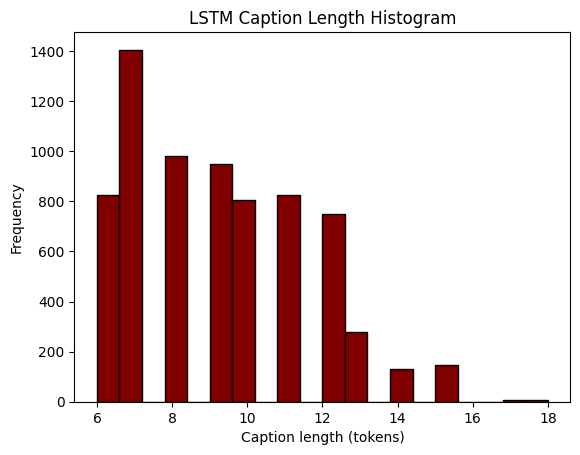

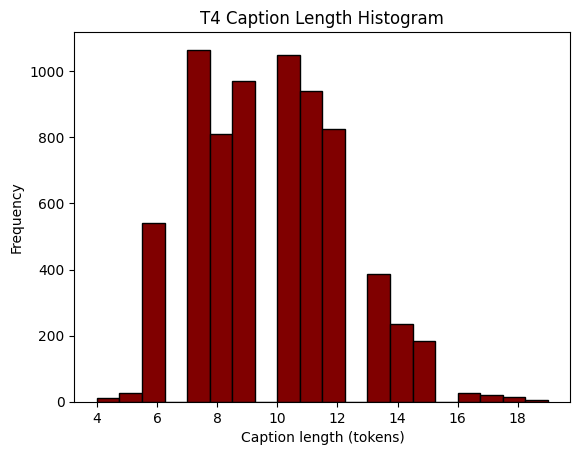

  Split  Total Tokens  OOV Tokens  OOV %  Vocab Coverage %  Mean Length  \
0  LSTM         65099           0    0.0             100.0         9.16   
1    T4         68974           0    0.0             100.0         9.71   

   Max Length  Min Length  
0          18           6  
1          19           4  


In [ ]:
! pip install matplotlib
import pandas as pd
import matplotlib.pyplot as plt
import re


# Load your splits
pred_df_LSTM  = pd.read_csv("/home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_2025_Guide-main/AML_Assignment/data/LSTM/test_set_predictions_per_sample_LSTM.csv")
pred_df_T4  = pd.read_csv("/home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_2025_Guide-main/AML_Assignment/data/preds_inference_transformer_T4.csv")


def tokenize(text: str):
    """
    Minimalist tokenizer:
    - lowercase
    - split on spaces
    - strip punctuation
    """
    if not isinstance(text, str):
        return []
    text = text.lower().strip()
    # remove punctuation except alphanumeric and spaces
    text = re.sub(r"[^a-z0-9\s]", "", text)
    return text.split()
def caption_stats(df, split_name, stoi):
    total_tokens = 0
    oov_tokens = 0
    lengths = []
    
    for cap in df["generated_beam3"]:
        toks = tokenize(cap)  # <-- use your tokenizer function
        lengths.append(len(toks))
        for t in toks:
            total_tokens += 1
            if t not in stoi:
                oov_tokens += 1
    
    coverage = 1 - (oov_tokens / total_tokens if total_tokens > 0 else 0)
    oov_pct = (oov_tokens / total_tokens * 100) if total_tokens > 0 else 0
    
    stats = {
        "Split": split_name,
        "Total Tokens": total_tokens,
        "OOV Tokens": oov_tokens,
        "OOV %": round(oov_pct, 2),
        "Vocab Coverage %": round(coverage * 100, 2),
        "Mean Length": round(sum(lengths)/len(lengths), 2),
        "Max Length": max(lengths),
        "Min Length": min(lengths)
    }
    
    # plot histogram
    plt.hist(lengths, bins=20, color="maroon", edgecolor="black")
    plt.title(f"{split_name} Caption Length Histogram")
    plt.xlabel("Caption length (tokens)")
    plt.ylabel("Frequency")
    plt.show()
    
    return stats

# Collect stats for all splits
stats_list = []
for split_name, df in [("LSTM", pred_df_LSTM), ("T4", pred_df_T4)]:
    stats_list.append(caption_stats(df, split_name, stoi))

# Save table
stats_df = pd.DataFrame(stats_list)
stats_df.to_csv("text_stats_2.csv", index=False)
print(stats_df)


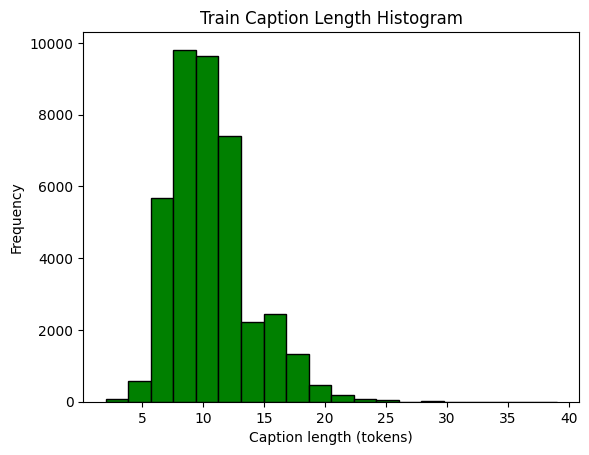

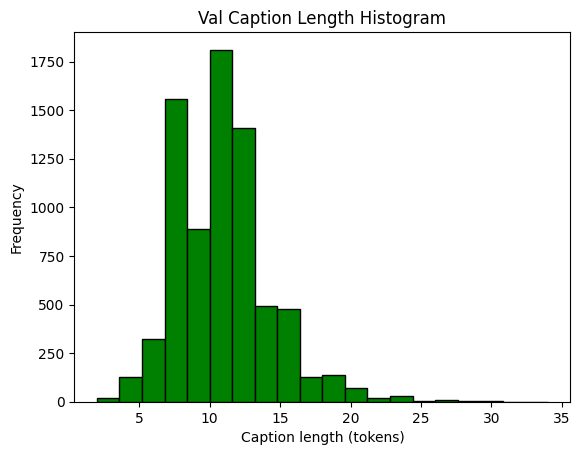

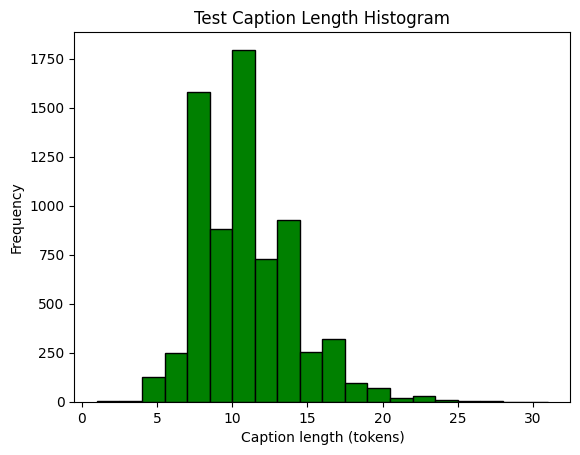

   Split  Total Tokens  OOV Tokens  OOV %  Vocab Coverage %  Mean Length  \
0  Train        426741        1020   0.24             99.76        10.67   
1    Val         80820         432   0.53             99.47        10.78   
2   Test         75556         416   0.55             99.45        10.64   

   Max Length  Min Length  
0          39           2  
1          34           2  
2          31           1  


In [125]:
! pip install matplotlib
import pandas as pd
import matplotlib.pyplot as plt

# Load your splits
train_df = pd.read_csv("data/train_exp.csv")
val_df   = pd.read_csv("data/val_exp.csv")
test_df  = pd.read_csv("data/test_exp.csv")

def caption_stats(df, split_name, stoi):
    total_tokens = 0
    oov_tokens = 0
    lengths = []
    
    for cap in df["caption"]:
        toks = tokenize(cap)  # <-- use your tokenizer function
        lengths.append(len(toks))
        for t in toks:
            total_tokens += 1
            if t not in stoi:
                oov_tokens += 1
    
    coverage = 1 - (oov_tokens / total_tokens if total_tokens > 0 else 0)
    oov_pct = (oov_tokens / total_tokens * 100) if total_tokens > 0 else 0
    
    stats = {
        "Split": split_name,
        "Total Tokens": total_tokens,
        "OOV Tokens": oov_tokens,
        "OOV %": round(oov_pct, 2),
        "Vocab Coverage %": round(coverage * 100, 2),
        "Mean Length": round(sum(lengths)/len(lengths), 2),
        "Max Length": max(lengths),
        "Min Length": min(lengths)
    }
    
    # plot histogram
    plt.hist(lengths, bins=20, color="green", edgecolor="black")
    plt.title(f"{split_name} Caption Length Histogram")
    plt.xlabel("Caption length (tokens)")
    plt.ylabel("Frequency")
    plt.show()
    
    return stats

# Collect stats for all splits
stats_list = []
for split_name, df in [("Train", train_df), ("Val", val_df), ("Test", test_df)]:
    stats_list.append(caption_stats(df, split_name, stoi))

# Save table
stats_df = pd.DataFrame(stats_list)
stats_df.to_csv("text_stats_1.csv", index=False)
print(stats_df)


In [126]:
import pandas as pd
import numpy as np
import re

# minimalist tokenizer
def tokenize(text: str):
    if not isinstance(text, str):
        return []
    text = text.lower().strip()
    text = re.sub(r"[^a-z0-9\s]", "", text)  # keep only alnum + spaces
    return text.split()

def analyze_captions(df, model_name="model"):
    results = []
    for col in ["ground_truth_caption", "generated_greedy", "generated_beam3"]:
        lens = []
        degens = 0
        for txt in df[col].dropna():
            toks = tokenize(txt)
            lens.append(len(toks))
            # check degeneracy: ≥3 identical tokens in a row
            for i in range(len(toks) - 2):
                if toks[i] == toks[i+1] == toks[i+2]:
                    degens += 1
                    break
        lens = np.array(lens)
        mean_len = lens.mean() if len(lens) else 0
        std_len = lens.std() if len(lens) else 0
        deg_pct = 100 * degens / len(lens) if len(lens) else 0
        results.append({
            "model": model_name,
            "caption_type": col,
            "mean_len": round(mean_len, 2),
            "std_len": round(std_len, 2),
            "degenerate_%": round(deg_pct, 2)
        })
    return pd.DataFrame(results)

# Example usage:
# LSTM
df_lstm = pd.read_csv("/home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_2025_Guide-main/AML_Assignment/generated_test_preds_LSTM.csv")
stats_lstm = analyze_captions(df_lstm, model_name="LSTM")

# Transformer
df_tran = pd.read_csv("/home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_2025_Guide-main/AML_Assignment/data/preds_inference_transformer_T4.csv")
stats_tran = analyze_captions(df_tran, model_name="Transformer")

# Combine
stats_all = pd.concat([stats_lstm, stats_tran], ignore_index=True)
print(stats_all)


         model          caption_type  mean_len  std_len  degenerate_%
0         LSTM  ground_truth_caption     10.64     3.23          0.01
1         LSTM      generated_greedy      9.85     2.62          0.00
2         LSTM       generated_beam3      9.16     2.32          0.00
3  Transformer  ground_truth_caption     10.64     3.23          0.01
4  Transformer      generated_greedy     10.49     2.64          0.00
5  Transformer       generated_beam3      9.71     2.44          0.00


## LSTM Failure Cases

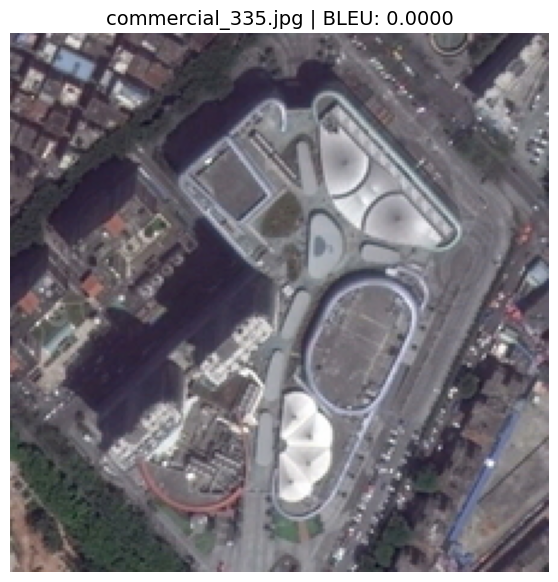


=== commercial_335.jpg | BLEU: 0.0000 ===
GT1: Theres an oval field next to the road.
GT2: The road was full of cars.
GT3: the road was full of cars.
GT4: Theres an oval field by the road.
GT5: there is an oval field beside the road.
Pred: many buildings are around a park with many green trees and a pond
--------------------------------------------------------------------------------


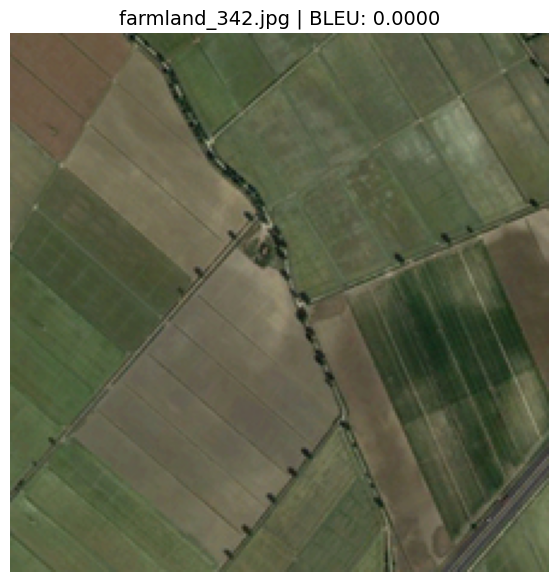


=== farmland_342.jpg | BLEU: 0.0000 ===
GT1: some trees were planted near the farm.
GT2: green fields grow some wheat.
GT3: the green fields grow some wheat.
GT4: some trees were planted near the farm.
GT5: some trees were planted near the farm.
Pred: many pieces of agricultural land are together
--------------------------------------------------------------------------------


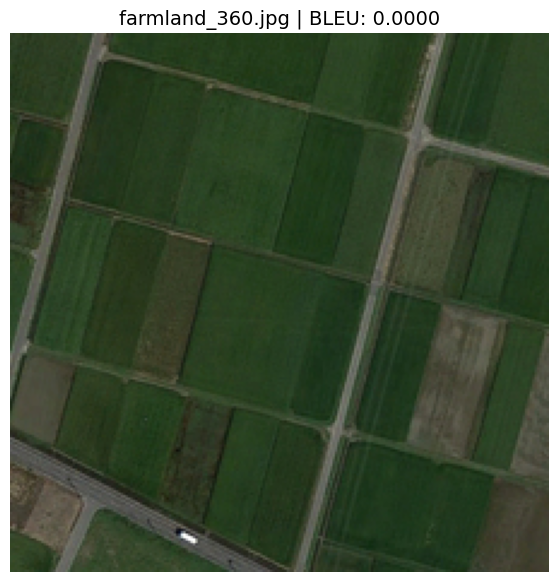


=== farmland_360.jpg | BLEU: 0.0000 ===
GT1: a road was built next to the wheat field.
GT2: next to the corn field is a green field.
GT3: next to the cornfield is a green field.
GT4: A road was built by the wheat field.
GT5: a road was built beside the wheat field.
Pred: many pieces of agricultural land are together
--------------------------------------------------------------------------------


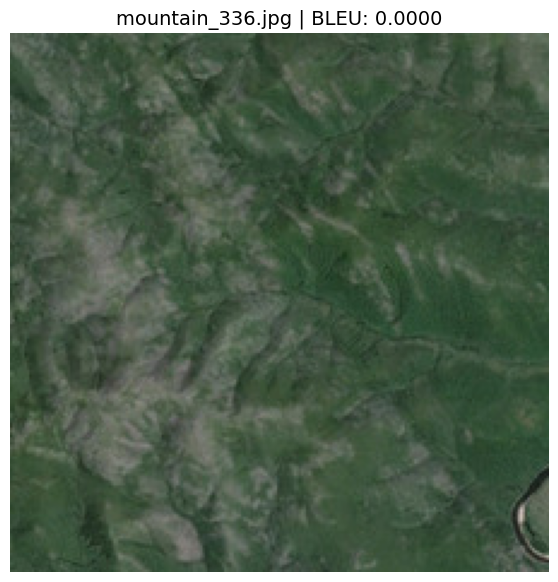


=== mountain_336.jpg | BLEU: 0.0000 ===
GT1: There are many rivers flowing through the mountains.
GT2: the river flows through the grass.
GT3: the river flows through the grass.
GT4: There are many rivers flowing through the mountains.
GT5: there are many rivers flowing through the mountains.
Pred: its a piece of green mountain
--------------------------------------------------------------------------------


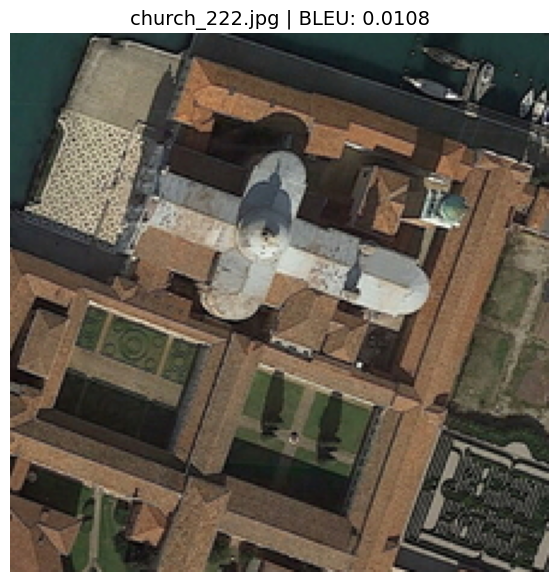


=== church_222.jpg | BLEU: 0.0108 ===
GT1: a red church with a white cross at the top is near a river with boats.
GT2: a red church with a white cross at the top is near a river with boats.
GT3: a red church with a white cross on top is located near a river with boats.
GT4: A red church with a white cross at the top is near a river with boats.
GT5: a red church with a white cross in top is near a river with boats.
Pred: several buildings are around a church
--------------------------------------------------------------------------------


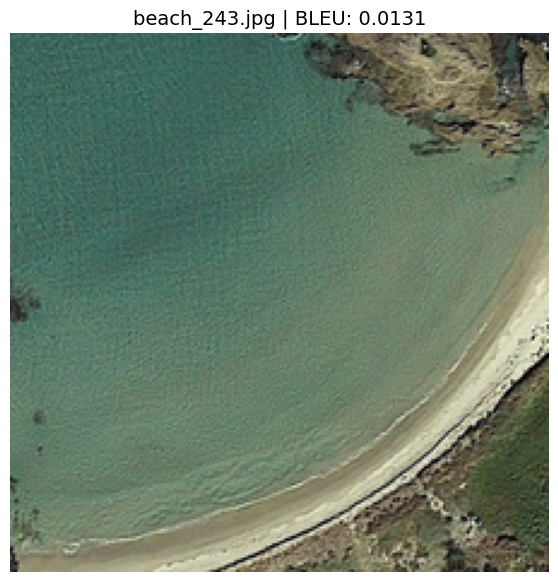


=== beach_243.jpg | BLEU: 0.0131 ===
GT1: a yellow ribbon beach is between green plants and the green ocean and black rocks.
GT2: a yellow ribbon beach lies between green and green ocean plants and black rocks.
GT3: a yellow ribbon beach lies between green plants and green ocean and black rocks.
GT4: a yellow ribbon beach is between green plants and green ocean and black rocks.
GT5: a yellow ribbon beach is between green plants and green ocean and black rocks.
Pred: many green trees are around an irregular pond
--------------------------------------------------------------------------------


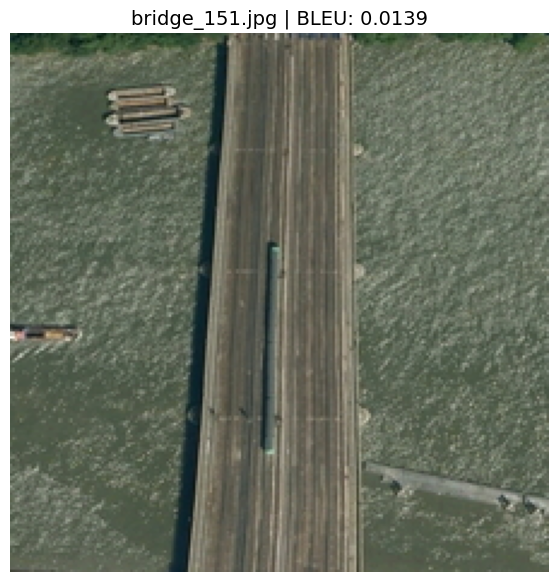


=== bridge_151.jpg | BLEU: 0.0139 ===
GT1: several boats are in a river with a bridge over it and some green trees near it.
GT2: several boats are on a river with a bridge on it and some green trees near it.
GT3: several boats are in a river with a bridge over it and some green trees near it.
GT4: several boats are on a river with a bridge in it and some green trees near it.
GT5: several boats are in a river with a bridge on it and some green trees near it.
Pred: a road is near a piece of green ocean
--------------------------------------------------------------------------------


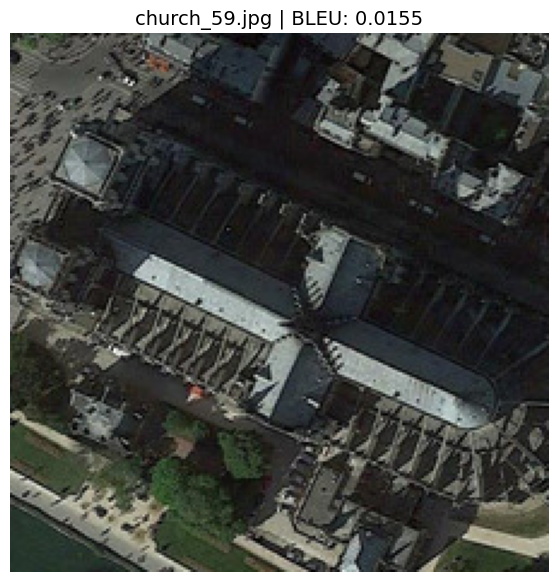


=== church_59.jpg | BLEU: 0.0155 ===
GT1: by the river there is a large church.
GT2: the church is surrounded by residential areas.
GT3: The big church seems a little dark.
GT4: the big church seems a little dark.
GT5: beside the river is a large church.
Pred: many buildings are around a park with many green trees and a pond
--------------------------------------------------------------------------------


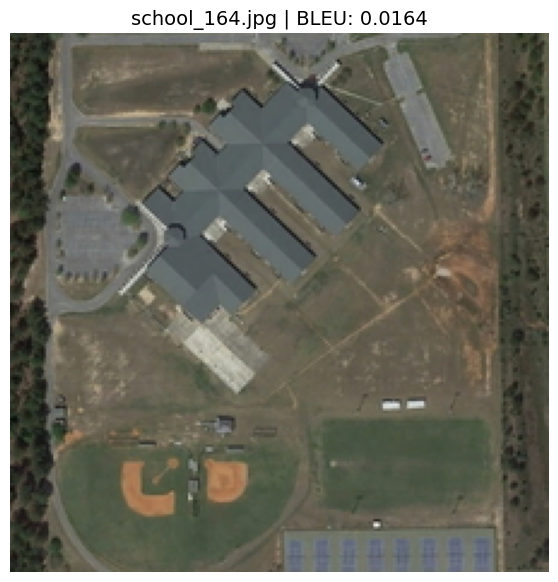


=== school_164.jpg | BLEU: 0.0164 ===
GT1: a large building is close to two baseball grounds and a row of tennis courts.
GT2: A large building is close to two baseball fields and a row of tennis courts.
GT3: A large building is close to two baseball fields and a row of tennis courts.
GT4: a large building is close to two baseball fields and a row of tennis courts.
GT5: a large building is near two baseball fields and a row of tennis courts.
Pred: some buildings and green trees are around a stadium
--------------------------------------------------------------------------------


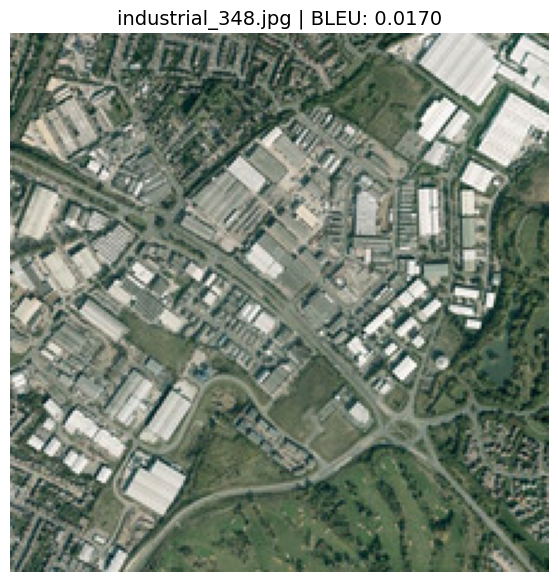


=== industrial_348.jpg | BLEU: 0.0170 ===
GT1: many roads around the factory.
GT2: next to the road is a large factory.
GT3: next to the road is a large factory.
GT4: Many roads around the factory.
GT5: many roads around the factory.
Pred: many buildings and some green trees are located in an industrial area
--------------------------------------------------------------------------------


In [131]:
import pandas as pd
import matplotlib.pyplot as plt
from nltk.translate.bleu_score import sentence_bleu, SmoothingFunction
import re, os
from PIL import Image
import textwrap

# --- Minimal tokenizer ---
def tokenize(text: str):
    if not isinstance(text, str):
        return []
    text = text.lower().strip()
    text = re.sub(r"[^a-z0-9\s]", "", text)
    return text.split()

# --- BLEU scorer ---
smooth_fn = SmoothingFunction().method1
def compute_bleu(gt_list, pred):
    refs = [tokenize(gt) for gt in gt_list if isinstance(gt, str)]
    hyp = tokenize(pred)
    if not hyp or not refs:
        return 0.0
    return sentence_bleu(refs, hyp, smoothing_function=smooth_fn)

# --- Load predictions ---
df = pd.read_csv("/home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_2025_Guide-main/AML_Assignment/generated_test_preds_LSTM.csv")  # your LSTM prediction file

# Group by filename
grouped = (
    df.groupby("filename")
    .agg({
        "ground_truth_caption": list,
        "generated_beam3": "first"
    })
    .reset_index()
)

# Compute BLEU per image
grouped["bleu"] = grouped.apply(lambda r: compute_bleu(r["ground_truth_caption"], r["generated_beam3"]), axis=1)

# Pick 10 worst images
worst_df = grouped.nsmallest(10, "bleu")

# --- Image root folder ---
IMAGE_ROOT = "/home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_2025_Guide-main/AML_Assignment/data/im_groot"  # <-- update this

for _, row in worst_df.iterrows():
    img_path = os.path.join(IMAGE_ROOT, row["filename"])
    if not os.path.exists(img_path):
        print(f"Image not found: {img_path}")
        continue

    img = Image.open(img_path)

    plt.figure(figsize=(7, 7))
    plt.imshow(img)
    plt.axis("off")

    # Title with filename + BLEU
    plt.title(f"{row['filename']} | BLEU: {row['bleu']:.4f}", fontsize=14)

    plt.show()

    # --- Print captions cleanly below ---
    print(f"\n=== {row['filename']} | BLEU: {row['bleu']:.4f} ===")
    for i, gt in enumerate(row["ground_truth_caption"], 1):
        print(f"GT{i}: {gt}")
    print(f"Pred: {row['generated_beam3']}\n" + "-"*80)


## LSTM Success Cases

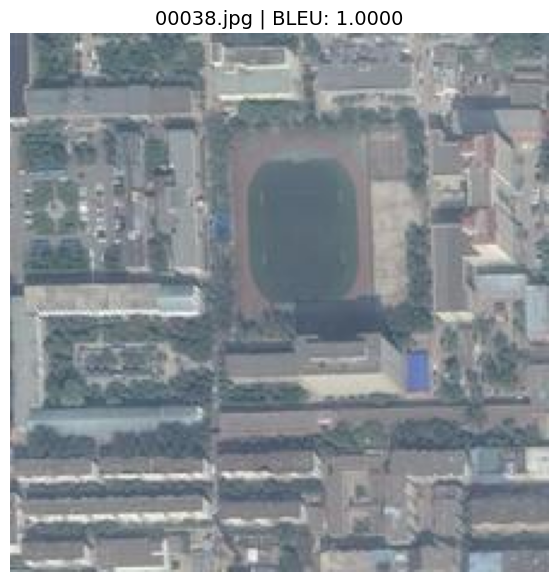


=== 00038.jpg | BLEU: 1.0000 ===
GT1: some tall buildings encircle the football field.
GT2: a square playground is surrounded by two forked roads.
GT3: many buildings and some green trees are around a playground.
GT4: a playground is surroundededed by many green trees and buildings.
GT5: a large playground is surrounded by many trees and houses.
Pred: many buildings and some green trees are around a playground
--------------------------------------------------------------------------------


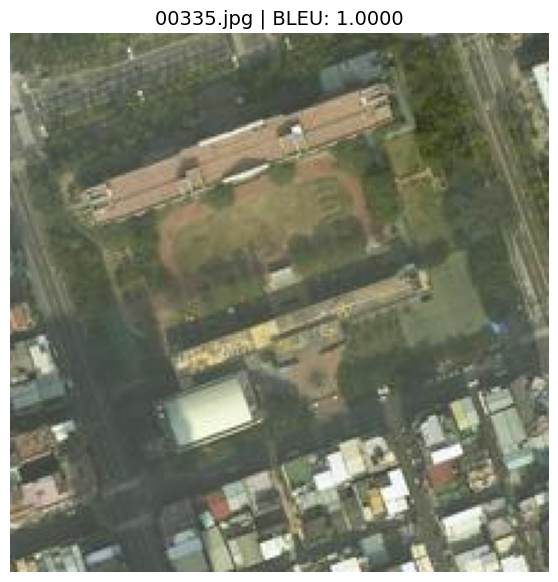


=== 00335.jpg | BLEU: 1.0000 ===
GT1: this area is a square, in which there is an oval football field in the middle of the tall buildings.
GT2: many buildings and some green trees are around a playground.
GT3: a playground is surrounded by many green plants and buildings.
GT4: a playground is surrounded by many green trees and buildings.
GT5: a playground is surrounded by many green plants and buildings.
Pred: many buildings and some green trees are around a playground
--------------------------------------------------------------------------------


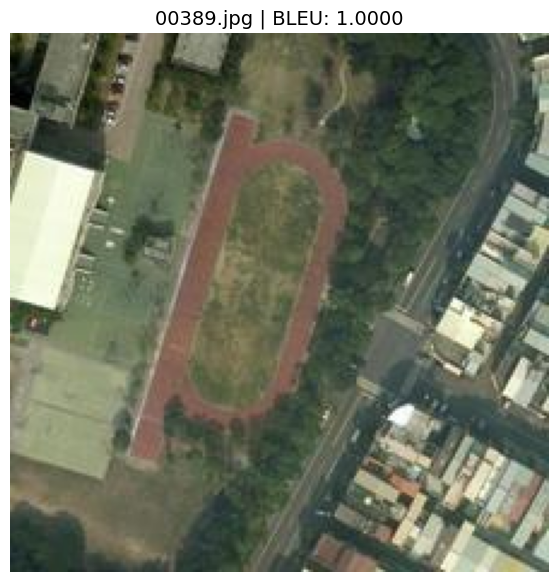


=== 00389.jpg | BLEU: 1.0000 ===
GT1: the playground is set in an open sapce which is behind the thick wood in the corner of the road.
GT2: many buildings and some green trees are around a playground.
GT3: a playground surrounded by many green plants and buildings is located next to a road.
GT4: a playground is surrounded by some green trees and many buildings.
GT5: a playground surrounded by many green plants and buildings is next to a road.
Pred: many buildings and some green trees are around a playground
--------------------------------------------------------------------------------


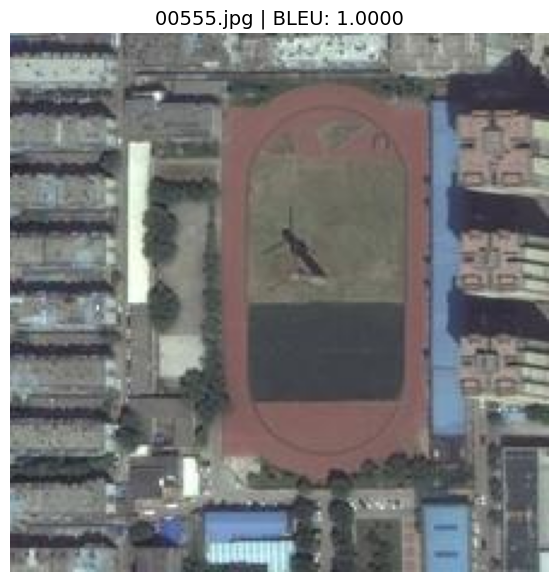


=== 00555.jpg | BLEU: 1.0000 ===
GT1: what surround this playground with a peculiar buildings are rows of edifices.
GT2: many buildings and some green trees are around a playground.
GT3: many buildings and some trees are around a playground.
GT4: a playground is surrounded by some green trees and many buildings.
GT5: many buildings and some trees are around a playground.
Pred: many buildings and some green trees are around a playground
--------------------------------------------------------------------------------


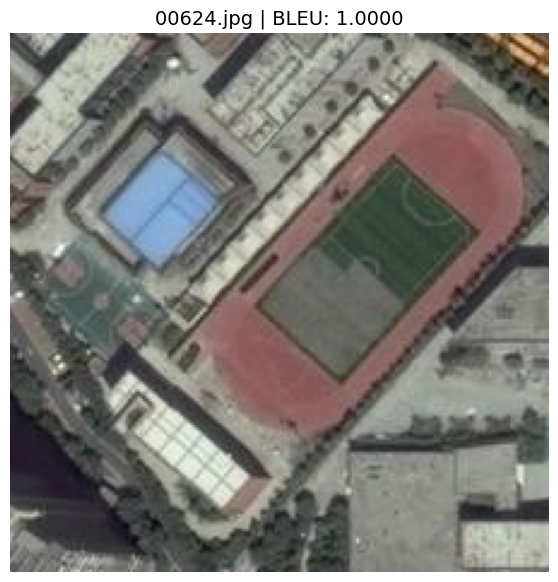


=== 00624.jpg | BLEU: 1.0000 ===
GT1: the block formed by two roads has a football field, a basketball court and several buildings.
GT2: many buildings and some green trees are around a playground and a basketball field.
GT3: a playground is surrounded by many buildings.
GT4: a playground with a basketball field next to it is surrounded by some green trees and many buildings.
GT5: a playground is surrounded by many buildings.
Pred: a playground is surrounded by many buildings
--------------------------------------------------------------------------------


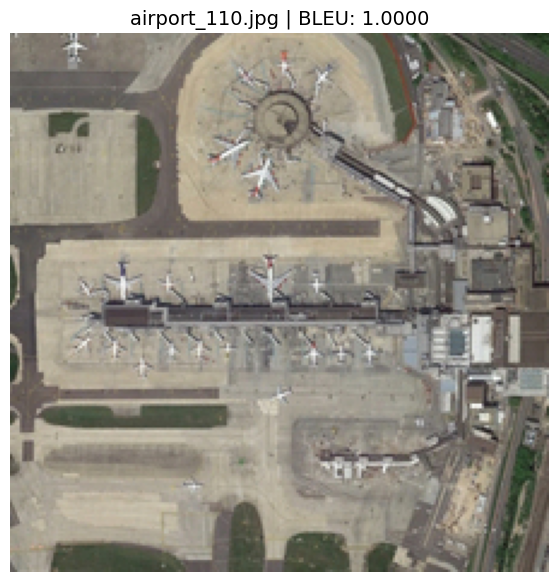


=== airport_110.jpg | BLEU: 1.0000 ===
GT1: Many aircraft are parked in an airport.
GT2: there are many different planes in the open airport.
GT3: there are many different planes in the open airport.
GT4: Many planes are parked at an airport.
GT5: many planes are parked in an airport.
Pred: many planes are parked in an airport
--------------------------------------------------------------------------------


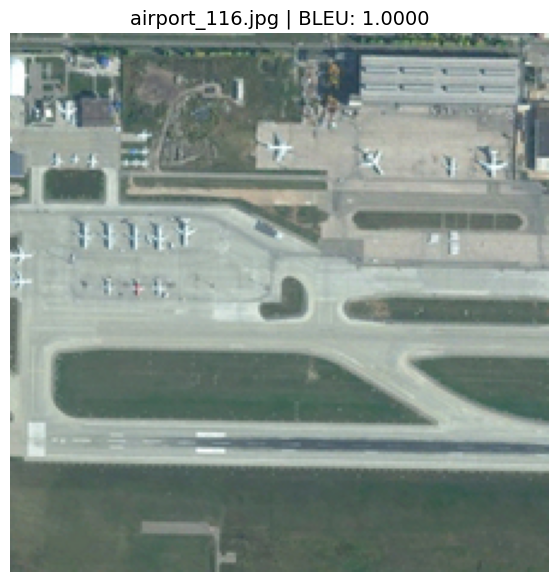


=== airport_116.jpg | BLEU: 1.0000 ===
GT1: Many aircraft are parked in an airport near several runways.
GT2: several green regions are in the airport.
GT3: several green regions are in the airport.
GT4: Many planes are parked at an airport near several runways.
GT5: many planes are parked in an airport near several runways.
Pred: many planes are parked in an airport
--------------------------------------------------------------------------------


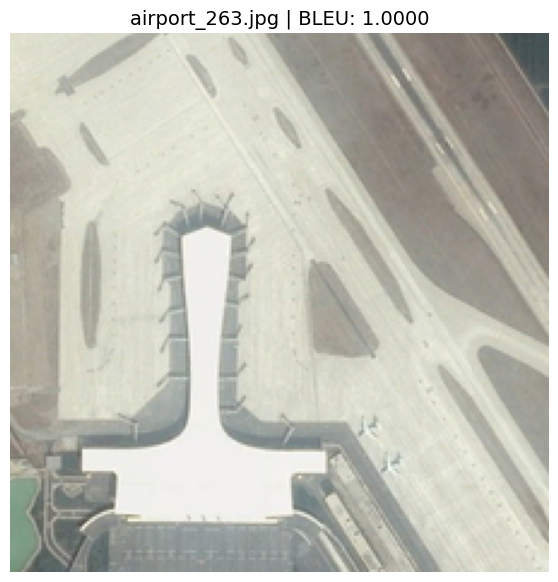


=== airport_263.jpg | BLEU: 1.0000 ===
GT1: several planes are near a terminal in an airport.
GT2: several planes are near a terminal at an airport.
GT3: Several planes are close to an airport terminal.
GT4: several planes are near a terminal at an airport.
GT5: several planes are near a terminal in an airport.
Pred: several planes are near a terminal in an airport
--------------------------------------------------------------------------------


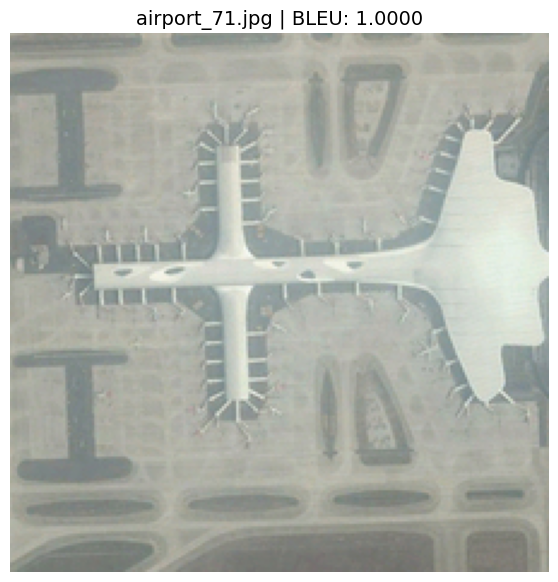


=== airport_71.jpg | BLEU: 1.0000 ===
GT1: Many aircraft are parked in an airport.
GT2: Many planes are parked at an airport.
GT3: Many planes are parked in an airport.
GT4: Many planes are parked at an airport.
GT5: many planes are parked in an airport.
Pred: many planes are parked in an airport
--------------------------------------------------------------------------------


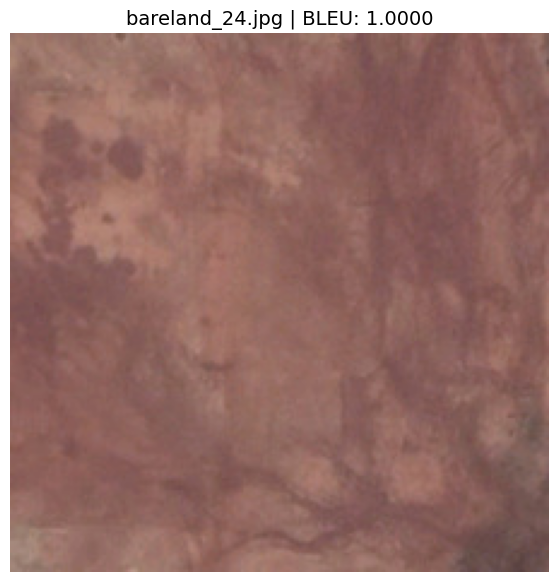


=== bareland_24.jpg | BLEU: 1.0000 ===
GT1: Its a piece of kaki nueland.
GT2: Its a piece of khaki bareland.
GT3: Its a piece of khaki stripping.
GT4: Its a piece of khaki bareland.
GT5: it is a piece of khaki bareland.
Pred: it is a piece of khaki bareland
--------------------------------------------------------------------------------


In [133]:
import pandas as pd
import matplotlib.pyplot as plt
from nltk.translate.bleu_score import sentence_bleu, SmoothingFunction
import re, os
from PIL import Image

# --- Minimal tokenizer ---
def tokenize(text: str):
    if not isinstance(text, str):
        return []
    text = text.lower().strip()
    text = re.sub(r"[^a-z0-9\s]", "", text)
    return text.split()

# --- BLEU scorer ---
smooth_fn = SmoothingFunction().method1
def compute_bleu(gt_list, pred):
    refs = [tokenize(gt) for gt in gt_list if isinstance(gt, str)]
    hyp = tokenize(pred)
    if not hyp or not refs:
        return 0.0
    return sentence_bleu(refs, hyp, smoothing_function=smooth_fn)

# --- Load predictions ---
df = pd.read_csv("/home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_2025_Guide-main/AML_Assignment/data/LSTM/test_set_predictions_per_sample_LSTM.csv")  # your LSTM prediction file

# Group by filename
grouped = (
    df.groupby("filename")
    .agg({
        "ground_truth_caption": list,
        "generated_beam3": "first"
    })
    .reset_index()
)

# Compute BLEU per image
grouped["bleu"] = grouped.apply(lambda r: compute_bleu(r["ground_truth_caption"], r["generated_beam3"]), axis=1)

# Pick 10 best images
best_df = grouped.nlargest(10, "bleu")

# --- Image root folder ---
IMAGE_ROOT = "/home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_2025_Guide-main/AML_Assignment/data/im_groot"  # <-- update this

for _, row in best_df.iterrows():
    img_path = os.path.join(IMAGE_ROOT, row["filename"])
    if not os.path.exists(img_path):
        print(f"Image not found: {img_path}")
        continue

    img = Image.open(img_path)

    plt.figure(figsize=(7, 7))
    plt.imshow(img)
    plt.axis("off")

    # Title with filename + BLEU
    plt.title(f"{row['filename']} | BLEU: {row['bleu']:.4f}", fontsize=14)

    plt.show()

    # --- Print captions cleanly below ---
    print(f"\n=== {row['filename']} | BLEU: {row['bleu']:.4f} ===")
    for i, gt in enumerate(row["ground_truth_caption"], 1):
        print(f"GT{i}: {gt}")
    print(f"Pred: {row['generated_beam3']}\n" + "-"*80)


## Transformer Failure


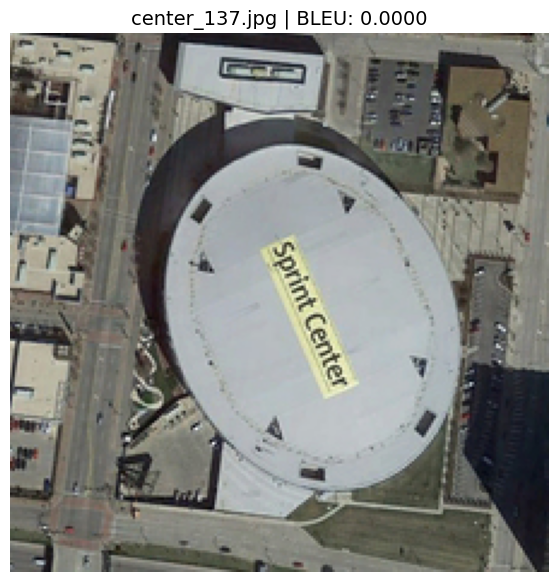


=== center_137.jpg | BLEU: 0.0000 ===
GT1: Many buildings are around a large oval building.
GT2: Many buildings are around a large oval building.
GT3: Many buildings are around a large oval building.
GT4: Many buildings are around a large oval building.
GT5: many buildings are around an oval large building.
Pred: the center is surrounded by dark green trees
--------------------------------------------------------------------------------


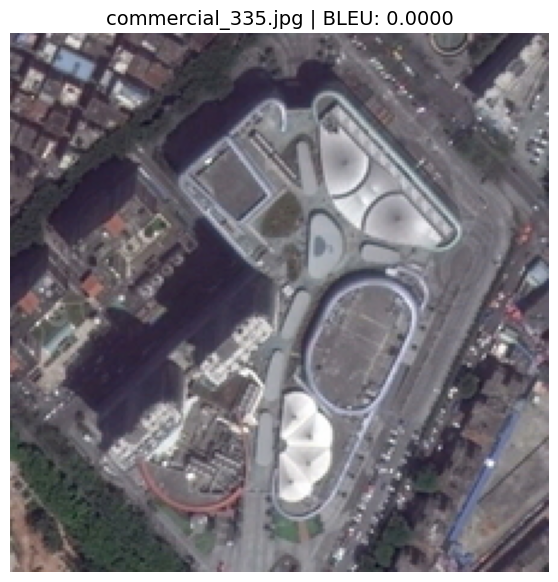


=== commercial_335.jpg | BLEU: 0.0000 ===
GT1: Theres an oval field next to the road.
GT2: The road was full of cars.
GT3: the road was full of cars.
GT4: Theres an oval field by the road.
GT5: there is an oval field beside the road.
Pred: many buildings are around a park with many green trees and a pond
--------------------------------------------------------------------------------


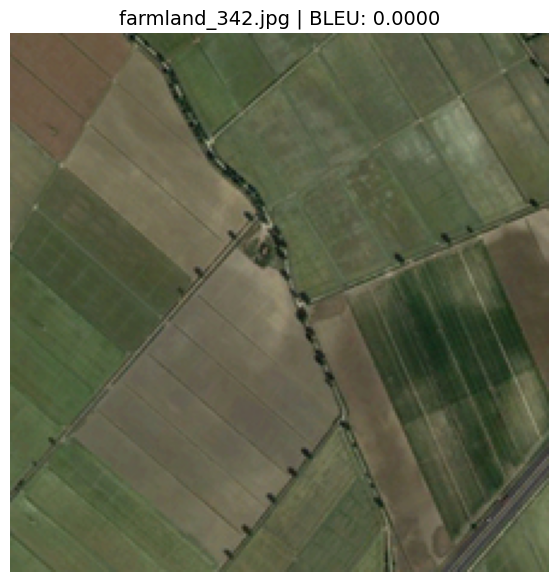


=== farmland_342.jpg | BLEU: 0.0000 ===
GT1: some trees were planted near the farm.
GT2: green fields grow some wheat.
GT3: the green fields grow some wheat.
GT4: some trees were planted near the farm.
GT5: some trees were planted near the farm.
Pred: many pieces of agricultural land are together
--------------------------------------------------------------------------------


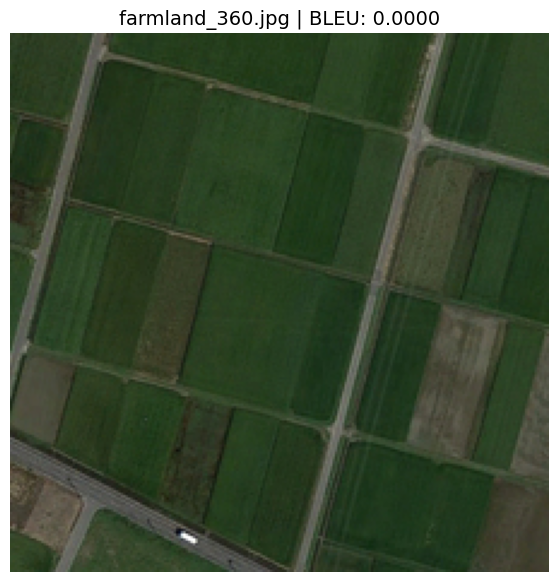


=== farmland_360.jpg | BLEU: 0.0000 ===
GT1: a road was built next to the wheat field.
GT2: next to the corn field is a green field.
GT3: next to the cornfield is a green field.
GT4: A road was built by the wheat field.
GT5: a road was built beside the wheat field.
Pred: many pieces of agricultural land are together
--------------------------------------------------------------------------------


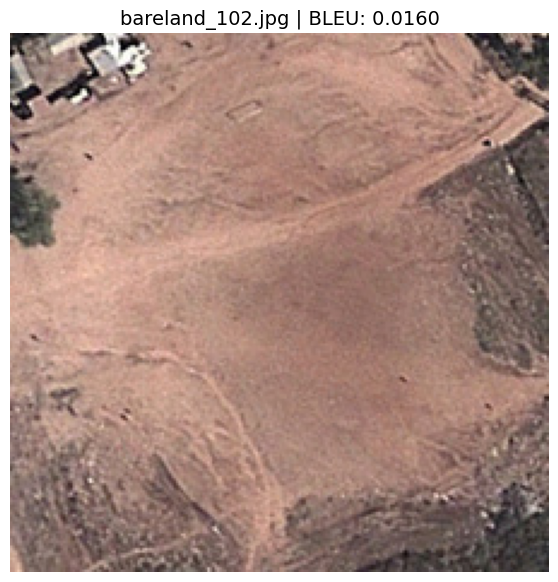


=== bareland_102.jpg | BLEU: 0.0160 ===
GT1: Here is a large area of bare land with some buildings and plants nearby.
GT2: Here is a large surface of bare land with some buildings and plants nearby.
GT3: here is a large area of bare land with some buildings and plants nearby.
GT4: here is a large area of bare land with some buildings and plants nearby.
GT5: here is an large area of bare land with some buildings and plants nearby.
Pred: its a big piece of naked land
--------------------------------------------------------------------------------


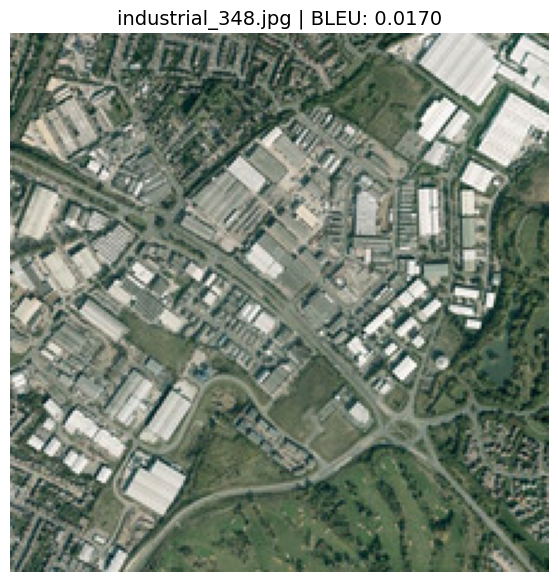


=== industrial_348.jpg | BLEU: 0.0170 ===
GT1: many roads around the factory.
GT2: next to the road is a large factory.
GT3: next to the road is a large factory.
GT4: Many roads around the factory.
GT5: many roads around the factory.
Pred: many buildings and some green trees are located in an industrial area
--------------------------------------------------------------------------------


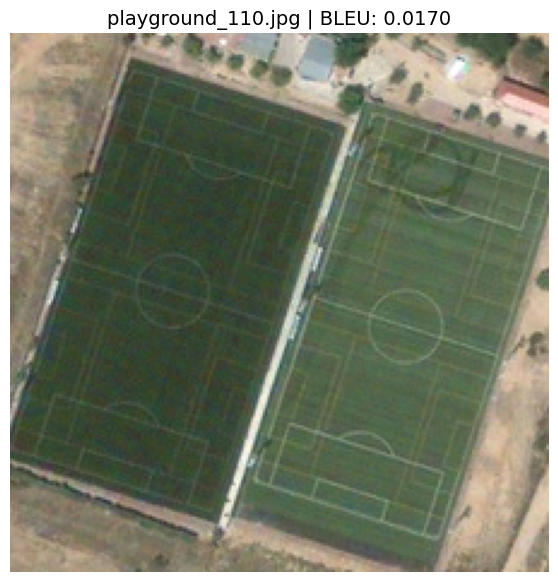


=== playground_110.jpg | BLEU: 0.0170 ===
GT1: two football fields are surrounded by bare ground.
GT2: Two football fields are surrounded by bare ground.
GT3: two football fields are surrounded by bareland.
GT4: two football fields are surrounded by bare land.
GT5: two football fields are surrounded by bareland.
Pred: a football field is close to several green trees and a building
--------------------------------------------------------------------------------


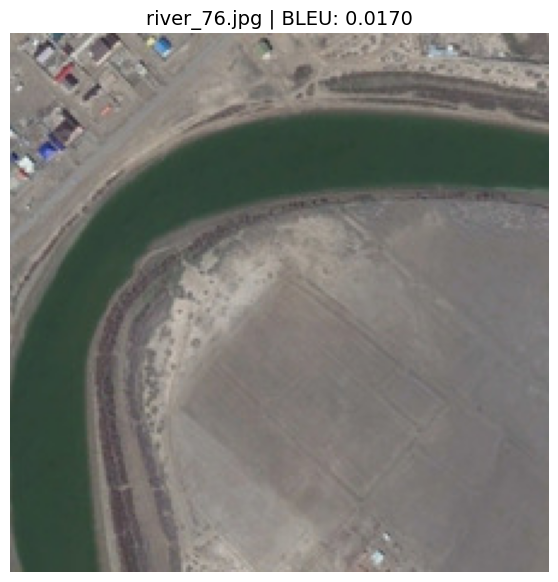


=== river_76.jpg | BLEU: 0.0170 ===
GT1: several buildings are near a curved river.
GT2: several buildings are near a curved river.
GT3: several buildings are near a curved river.
GT4: several buildings are near a curved river.
GT5: several buildings are near a curved river.
Pred: an almost rectangular beach is close to a piece of green meadows
--------------------------------------------------------------------------------


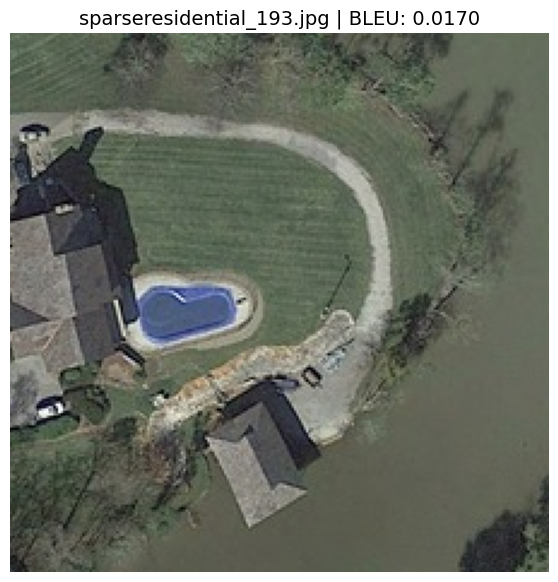


=== sparseresidential_193.jpg | BLEU: 0.0170 ===
GT1: two buildings with a pond is near a river with some sparse green trees on two sides.
GT2: a brown roof house is built on a lawn as well as a swimming pool where several trees grow around.
GT3: a brown roof house is built on a lawn together with a swimming pool  where several trees are growing around.
GT4: a swimming pool sits in front of the smart house is surrounded by the meadow with a road stretched to it.
GT5: two buildings with a pond is near a river with some sparse green trees in two sides.
Pred: a building is close to a piece of green meadow
--------------------------------------------------------------------------------


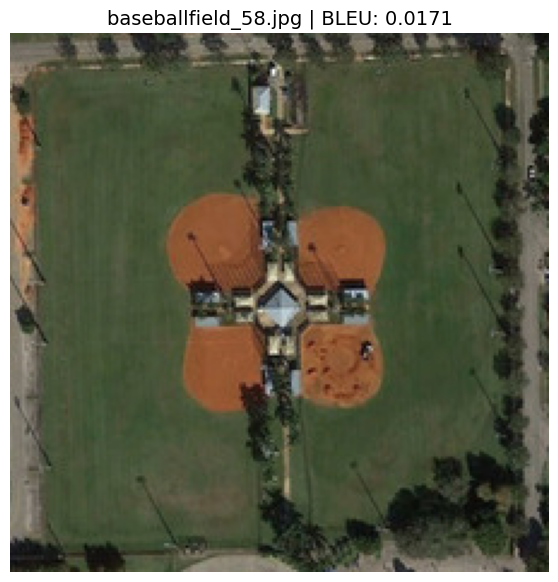


=== baseballfield_58.jpg | BLEU: 0.0171 ===
GT1: In the middle of the green grass is a house with a blue roof.
GT2: Under the house is a brown land.
GT3: under the house is a brown land.
GT4: In the middle of the green grass is a house with a blue ceiling.
GT5: in the middle of the green grass is a house with a blue roof.
Pred: several buildings and many green trees are around a baseball field
--------------------------------------------------------------------------------


In [134]:
import pandas as pd
import matplotlib.pyplot as plt
from nltk.translate.bleu_score import sentence_bleu, SmoothingFunction
import re, os
from PIL import Image
import textwrap

# --- Minimal tokenizer ---
def tokenize(text: str):
    if not isinstance(text, str):
        return []
    text = text.lower().strip()
    text = re.sub(r"[^a-z0-9\s]", "", text)
    return text.split()

# --- BLEU scorer ---
smooth_fn = SmoothingFunction().method1
def compute_bleu(gt_list, pred):
    refs = [tokenize(gt) for gt in gt_list if isinstance(gt, str)]
    hyp = tokenize(pred)
    if not hyp or not refs:
        return 0.0
    return sentence_bleu(refs, hyp, smoothing_function=smooth_fn)

# --- Load predictions ---
df = pd.read_csv("/home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_2025_Guide-main/AML_Assignment/data/preds_inference_transformer_T4.csv")  # your LSTM prediction file

# Group by filename
grouped = (
    df.groupby("filename")
    .agg({
        "ground_truth_caption": list,
        "generated_beam3": "first"
    })
    .reset_index()
)

# Compute BLEU per image
grouped["bleu"] = grouped.apply(lambda r: compute_bleu(r["ground_truth_caption"], r["generated_beam3"]), axis=1)

# Pick 10 worst images
worst_df = grouped.nsmallest(10, "bleu")

# --- Image root folder ---
IMAGE_ROOT = "/home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_2025_Guide-main/AML_Assignment/data/im_groot"  # <-- update this

for _, row in worst_df.iterrows():
    img_path = os.path.join(IMAGE_ROOT, row["filename"])
    if not os.path.exists(img_path):
        print(f"Image not found: {img_path}")
        continue

    img = Image.open(img_path)

    plt.figure(figsize=(7, 7))
    plt.imshow(img)
    plt.axis("off")

    # Title with filename + BLEU
    plt.title(f"{row['filename']} | BLEU: {row['bleu']:.4f}", fontsize=14)

    plt.show()

    # --- Print captions cleanly below ---
    print(f"\n=== {row['filename']} | BLEU: {row['bleu']:.4f} ===")
    for i, gt in enumerate(row["ground_truth_caption"], 1):
        print(f"GT{i}: {gt}")
    print(f"Pred: {row['generated_beam3']}\n" + "-"*80)


## Transformer Success

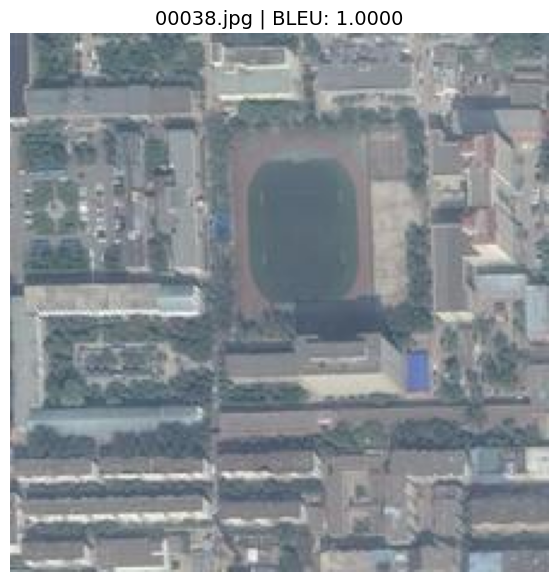


=== 00038.jpg | BLEU: 1.0000 ===
GT1: some tall buildings encircle the football field.
GT2: a square playground is surrounded by two forked roads.
GT3: many buildings and some green trees are around a playground.
GT4: a playground is surroundededed by many green trees and buildings.
GT5: a large playground is surrounded by many trees and houses.
Pred: many buildings and some green trees are around a playground
--------------------------------------------------------------------------------


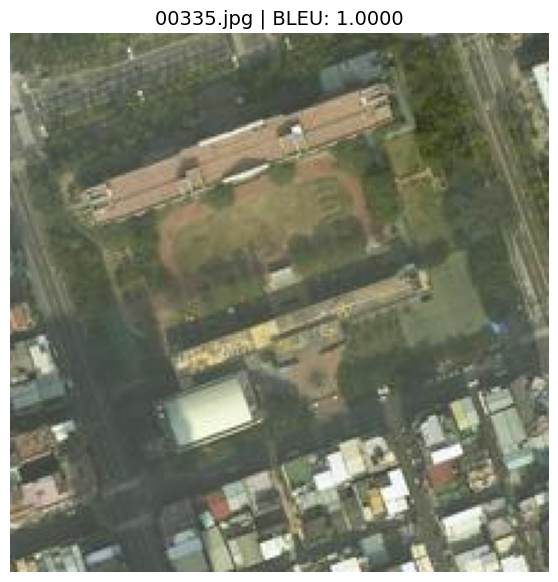


=== 00335.jpg | BLEU: 1.0000 ===
GT1: this area is a square, in which there is an oval football field in the middle of the tall buildings.
GT2: many buildings and some green trees are around a playground.
GT3: a playground is surrounded by many green plants and buildings.
GT4: a playground is surrounded by many green trees and buildings.
GT5: a playground is surrounded by many green plants and buildings.
Pred: many buildings and some green trees are around a playground
--------------------------------------------------------------------------------


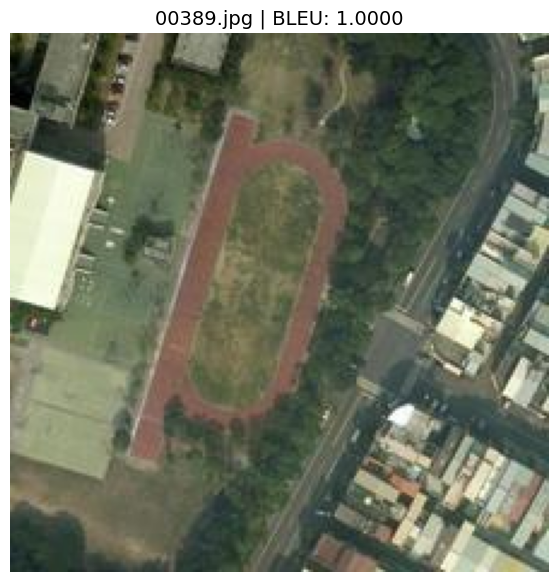


=== 00389.jpg | BLEU: 1.0000 ===
GT1: the playground is set in an open sapce which is behind the thick wood in the corner of the road.
GT2: many buildings and some green trees are around a playground.
GT3: a playground surrounded by many green plants and buildings is located next to a road.
GT4: a playground is surrounded by some green trees and many buildings.
GT5: a playground surrounded by many green plants and buildings is next to a road.
Pred: many buildings and some green trees are around a playground
--------------------------------------------------------------------------------


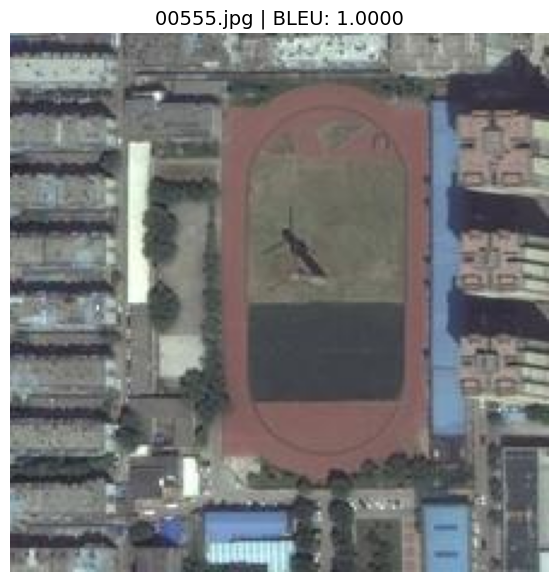


=== 00555.jpg | BLEU: 1.0000 ===
GT1: what surround this playground with a peculiar buildings are rows of edifices.
GT2: many buildings and some green trees are around a playground.
GT3: many buildings and some trees are around a playground.
GT4: a playground is surrounded by some green trees and many buildings.
GT5: many buildings and some trees are around a playground.
Pred: many buildings and some green trees are around a playground
--------------------------------------------------------------------------------


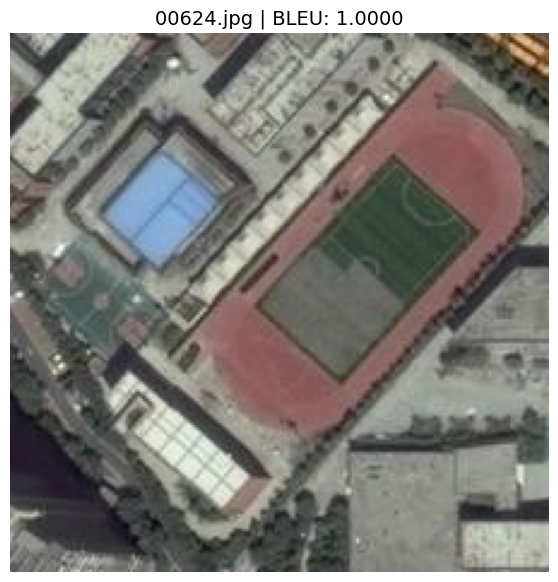


=== 00624.jpg | BLEU: 1.0000 ===
GT1: the block formed by two roads has a football field, a basketball court and several buildings.
GT2: many buildings and some green trees are around a playground and a basketball field.
GT3: a playground is surrounded by many buildings.
GT4: a playground with a basketball field next to it is surrounded by some green trees and many buildings.
GT5: a playground is surrounded by many buildings.
Pred: a playground is surrounded by many buildings
--------------------------------------------------------------------------------


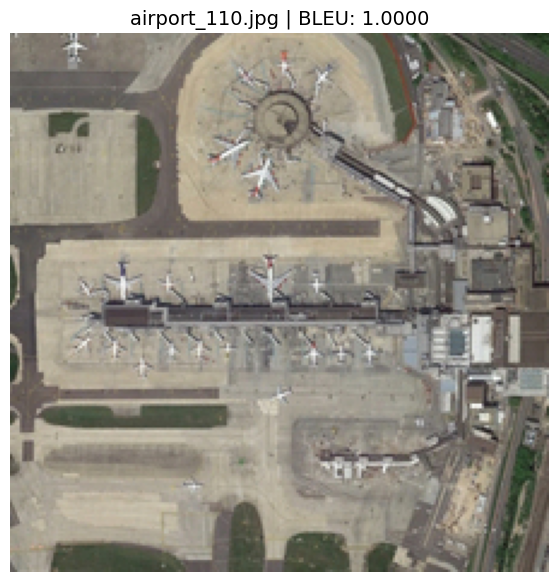


=== airport_110.jpg | BLEU: 1.0000 ===
GT1: Many aircraft are parked in an airport.
GT2: there are many different planes in the open airport.
GT3: there are many different planes in the open airport.
GT4: Many planes are parked at an airport.
GT5: many planes are parked in an airport.
Pred: many planes are parked in an airport
--------------------------------------------------------------------------------


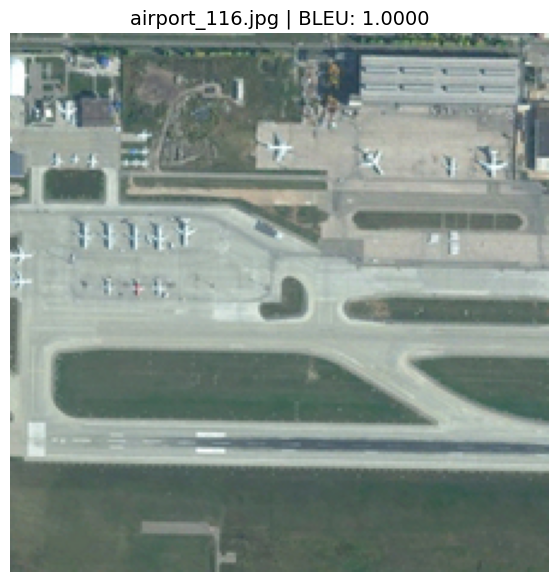


=== airport_116.jpg | BLEU: 1.0000 ===
GT1: Many aircraft are parked in an airport near several runways.
GT2: several green regions are in the airport.
GT3: several green regions are in the airport.
GT4: Many planes are parked at an airport near several runways.
GT5: many planes are parked in an airport near several runways.
Pred: many planes are parked in an airport
--------------------------------------------------------------------------------


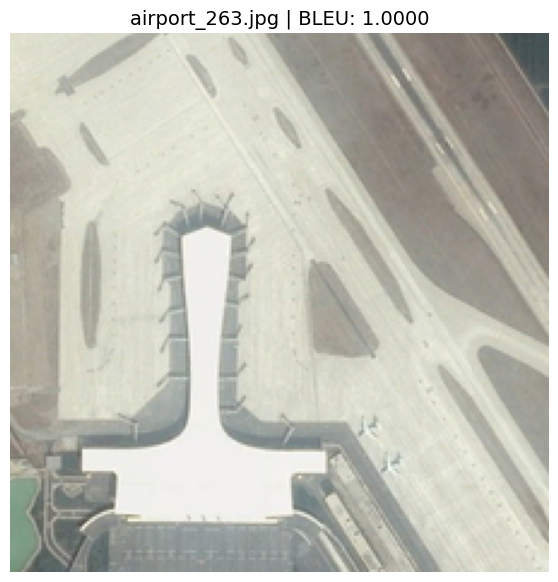


=== airport_263.jpg | BLEU: 1.0000 ===
GT1: several planes are near a terminal in an airport.
GT2: several planes are near a terminal at an airport.
GT3: Several planes are close to an airport terminal.
GT4: several planes are near a terminal at an airport.
GT5: several planes are near a terminal in an airport.
Pred: several planes are near a terminal in an airport
--------------------------------------------------------------------------------


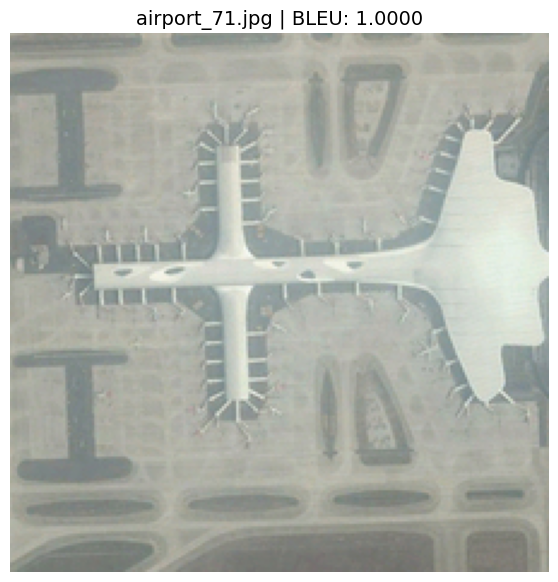


=== airport_71.jpg | BLEU: 1.0000 ===
GT1: Many aircraft are parked in an airport.
GT2: Many planes are parked at an airport.
GT3: Many planes are parked in an airport.
GT4: Many planes are parked at an airport.
GT5: many planes are parked in an airport.
Pred: many planes are parked in an airport
--------------------------------------------------------------------------------


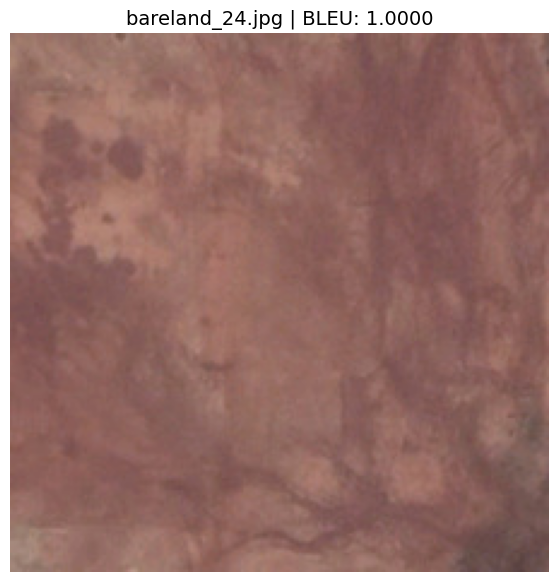


=== bareland_24.jpg | BLEU: 1.0000 ===
GT1: Its a piece of kaki nueland.
GT2: Its a piece of khaki bareland.
GT3: Its a piece of khaki stripping.
GT4: Its a piece of khaki bareland.
GT5: it is a piece of khaki bareland.
Pred: it is a piece of khaki bareland
--------------------------------------------------------------------------------


In [135]:
import pandas as pd
import matplotlib.pyplot as plt
from nltk.translate.bleu_score import sentence_bleu, SmoothingFunction
import re, os
from PIL import Image

# --- Minimal tokenizer ---
def tokenize(text: str):
    if not isinstance(text, str):
        return []
    text = text.lower().strip()
    text = re.sub(r"[^a-z0-9\s]", "", text)
    return text.split()

# --- BLEU scorer ---
smooth_fn = SmoothingFunction().method1
def compute_bleu(gt_list, pred):
    refs = [tokenize(gt) for gt in gt_list if isinstance(gt, str)]
    hyp = tokenize(pred)
    if not hyp or not refs:
        return 0.0
    return sentence_bleu(refs, hyp, smoothing_function=smooth_fn)

# --- Load predictions ---
df = pd.read_csv("/home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_2025_Guide-main/AML_Assignment/data/LSTM/test_set_predictions_per_sample_LSTM.csv")  # your LSTM prediction file

# Group by filename
grouped = (
    df.groupby("filename")
    .agg({
        "ground_truth_caption": list,
        "generated_beam3": "first"
    })
    .reset_index()
)

# Compute BLEU per image
grouped["bleu"] = grouped.apply(lambda r: compute_bleu(r["ground_truth_caption"], r["generated_beam3"]), axis=1)

# Pick 10 best images
best_df = grouped.nlargest(10, "bleu")

# --- Image root folder ---
IMAGE_ROOT = "/home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_2025_Guide-main/AML_Assignment/data/im_groot"  # <-- update this

for _, row in best_df.iterrows():
    img_path = os.path.join(IMAGE_ROOT, row["filename"])
    if not os.path.exists(img_path):
        print(f"Image not found: {img_path}")
        continue

    img = Image.open(img_path)

    plt.figure(figsize=(7, 7))
    plt.imshow(img)
    plt.axis("off")

    # Title with filename + BLEU
    plt.title(f"{row['filename']} | BLEU: {row['bleu']:.4f}", fontsize=14)

    plt.show()

    # --- Print captions cleanly below ---
    print(f"\n=== {row['filename']} | BLEU: {row['bleu']:.4f} ===")
    for i, gt in enumerate(row["ground_truth_caption"], 1):
        print(f"GT{i}: {gt}")
    print(f"Pred: {row['generated_beam3']}\n" + "-"*80)


##  Error Slices
generated_set_predictions_per_sample_LSTM and generated_test_preds_LSTM are same files

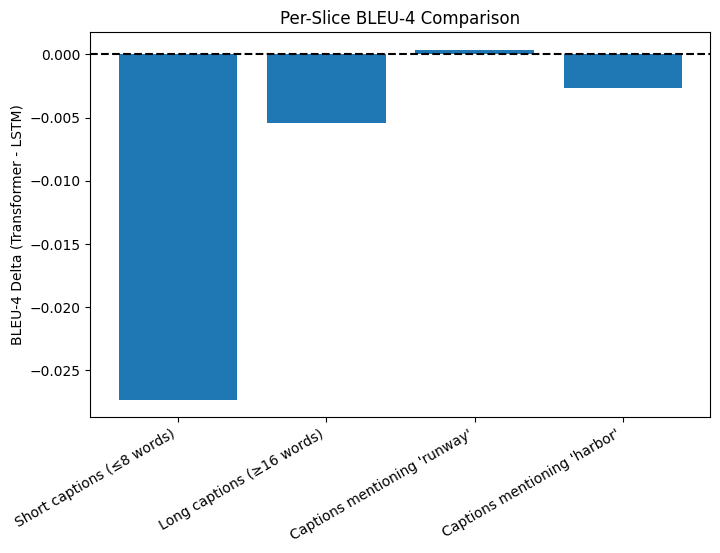

                          Slice  BLEU_LSTM  BLEU_Trans  Delta (Trans - LSTM)
0     Short captions (≤8 words)   0.239125    0.211797             -0.027328
1     Long captions (≥16 words)   0.129273    0.123826             -0.005447
2  Captions mentioning 'runway'   0.073135    0.073509              0.000373
3  Captions mentioning 'harbor'   0.061031    0.058340             -0.002691


In [139]:
import pandas as pd
import matplotlib.pyplot as plt
from nltk.translate.bleu_score import sentence_bleu, SmoothingFunction

# --- Load CSVs ---
lstm_df = pd.read_csv("/home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_2025_Guide-main/AML_Assignment/generated_test_preds_LSTM.csv")
trans_df = pd.read_csv("/home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_2025_Guide-main/AML_Assignment/data/preds_inference_transformer_T4.csv")

# --- Add model-specific column names before merging ---
lstm_df = lstm_df.rename(columns={"generated_greedy": "generated_beam3_lstm"})
trans_df = trans_df.rename(columns={"generated_greedy": "generated_beam3_trans"})

# --- Merge on filename and ground truth caption ---
df = pd.merge(lstm_df[["filename", "ground_truth_caption", "generated_beam3_lstm"]],
              trans_df[["filename", "ground_truth_caption", "generated_beam3_trans"]],
              on=["filename", "ground_truth_caption"],
              how="inner")

# --- Simple tokenizer ---
def tokenize(text):
    return str(text).lower().split()

# --- BLEU helper ---
smooth_fn = SmoothingFunction().method1
def bleu_score(pred, ref):
    try:
        return sentence_bleu([tokenize(ref)], tokenize(pred), smoothing_function=smooth_fn)
    except:
        return 0.0

# Compute BLEU for each model
df["bleu_lstm"] = df.apply(lambda x: bleu_score(x["generated_beam3_lstm"], x["ground_truth_caption"]), axis=1)
df["bleu_trans"] = df.apply(lambda x: bleu_score(x["generated_beam3_trans"], x["ground_truth_caption"]), axis=1)

# --- Define error slices ---
slices = {
    "Short captions (≤8 words)": df["ground_truth_caption"].apply(lambda x: len(tokenize(x)) <= 8),
    "Long captions (≥16 words)": df["ground_truth_caption"].apply(lambda x: len(tokenize(x)) >= 16),
    "Captions mentioning 'runway'": df["ground_truth_caption"].str.contains("runway", case=False, na=False),
    "Captions mentioning 'harbor'": df["ground_truth_caption"].str.contains("harbor", case=False, na=False),
}

# --- Compute per-slice BLEU deltas ---
results = []
for slice_name, mask in slices.items():
    sub = df[mask]
    if len(sub) == 0:
        continue
    mean_lstm = sub["bleu_lstm"].mean()
    mean_trans = sub["bleu_trans"].mean()
    delta = mean_trans - mean_lstm
    results.append((slice_name, mean_lstm, mean_trans, delta))

slice_df = pd.DataFrame(results, columns=["Slice", "BLEU_LSTM", "BLEU_Trans", "Delta (Trans - LSTM)"])

# --- Plot ---
plt.figure(figsize=(8, 5))
plt.bar(slice_df["Slice"], slice_df["Delta (Trans - LSTM)"])
plt.axhline(0, color="black", linestyle="--")
plt.ylabel("BLEU-4 Delta (Transformer - LSTM)")
plt.title("Per-Slice BLEU-4 Comparison")
plt.xticks(rotation=30, ha="right")
plt.show()

print(slice_df)


## GradCAM


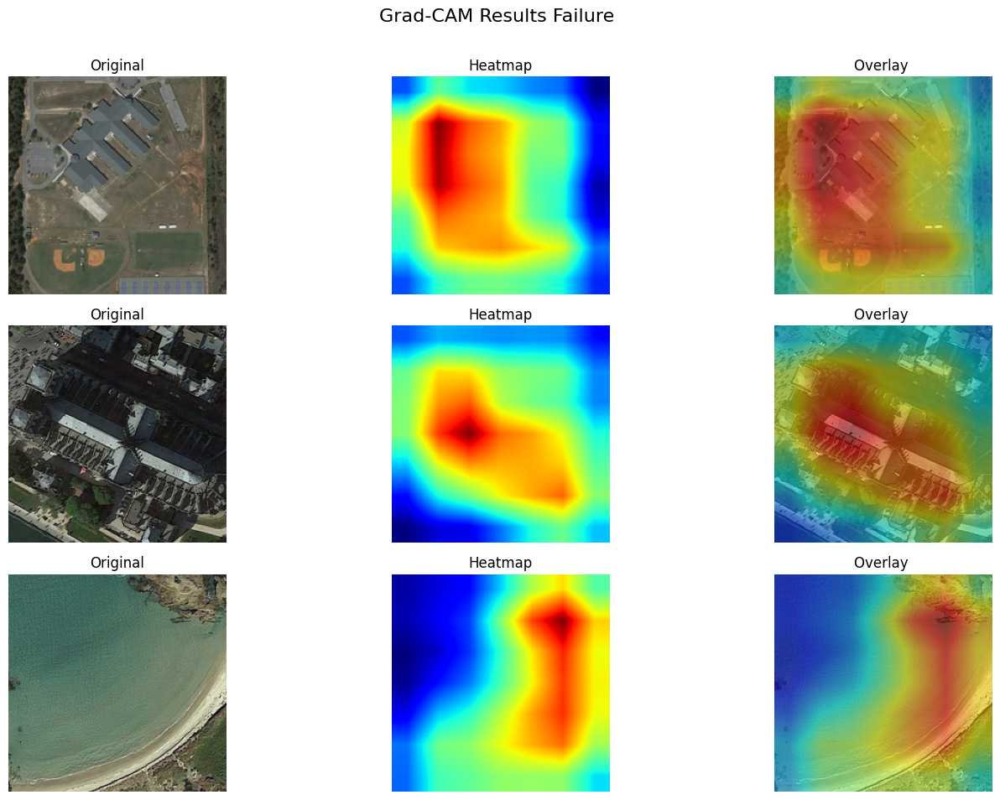

<Figure size 640x480 with 0 Axes>

In [165]:
# Updated Grad-CAM for multiple images
def generate_gradcam_multiple(image_paths, backbone, transform, device):
    results = []
    for image_path in image_paths:
        img_pil = Image.open(image_path).convert('RGB')
        img_tensor = transform(img_pil).unsqueeze(0).to(device)
        original_img = cv2.cvtColor(np.array(img_pil), cv2.COLOR_RGB2BGR)
        original_img = cv2.resize(original_img, (224, 224))
        
        # Target layer: last conv block of ResNet-18 (layer4)
        target_layer = backbone[7]
        grad_cam = GradCAM(backbone, target_layer)
        
        # Forward + target
        features = grad_cam.forward(img_tensor)
        target = features.norm()
        
        # Backward
        grad_cam.backward(target)
        
        activations = grad_cam.activations[0].cpu().numpy()
        gradients = grad_cam.gradients[0].cpu().numpy()
        weights = np.mean(gradients, axis=(1, 2))
        
        # Heatmap
        heatmap = np.zeros(activations.shape[1:], dtype=np.float32)
        for i, w in enumerate(weights):
            heatmap += w * activations[i, :, :]
        
        heatmap = np.maximum(heatmap, 0)
        heatmap /= np.max(heatmap) if np.max(heatmap) != 0 else 1
        heatmap = cv2.resize(heatmap, (224, 224))
        
        # Overlay
        heatmap_uint8 = np.uint8(255 * heatmap)
        heatmap_colored = cv2.applyColorMap(heatmap_uint8, cv2.COLORMAP_JET)
        superimposed_img = heatmap_colored * 0.5 + original_img * 0.5
        superimposed_img = np.clip(superimposed_img, 0, 255).astype(np.uint8)
        
        results.append((original_img, heatmap, superimposed_img))
    return results


# Example with 3 images
image_paths = [
    "/home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_2025_Guide-main/AML_Assignment/data/im_groot/school_164.jpg",
    "/home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_2025_Guide-main/AML_Assignment/data/im_groot/church_59.jpg",
    "/home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_2025_Guide-main/AML_Assignment/data/im_groot/beach_243.jpg"
]

results = generate_gradcam_multiple(image_paths, backbone, image_transform, device)

# Plot results
plt.figure(figsize=(15, 10))
for idx, (original_img, heatmap, superimposed_img) in enumerate(results):
    plt.subplot(len(results), 3, idx*3 + 1)
    plt.imshow(cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB))
    plt.title(f'Original')
    plt.axis('off')
    
    plt.subplot(len(results), 3, idx*3 + 2)
    plt.imshow(heatmap, cmap='jet')
    plt.title(f'Heatmap')
    plt.axis('off')
    
    plt.subplot(len(results), 3, idx*3 + 3)
    plt.imshow(cv2.cvtColor(superimposed_img, cv2.COLOR_BGR2RGB))
    plt.title(f'Overlay ')
    plt.axis('off')
plt.suptitle("Grad-CAM Results Failure ", fontsize=16, y=0.95)
plt.tight_layout(rect=[0, 0, 1, 0.94])
plt.show()    

plt.tight_layout()
plt.show()




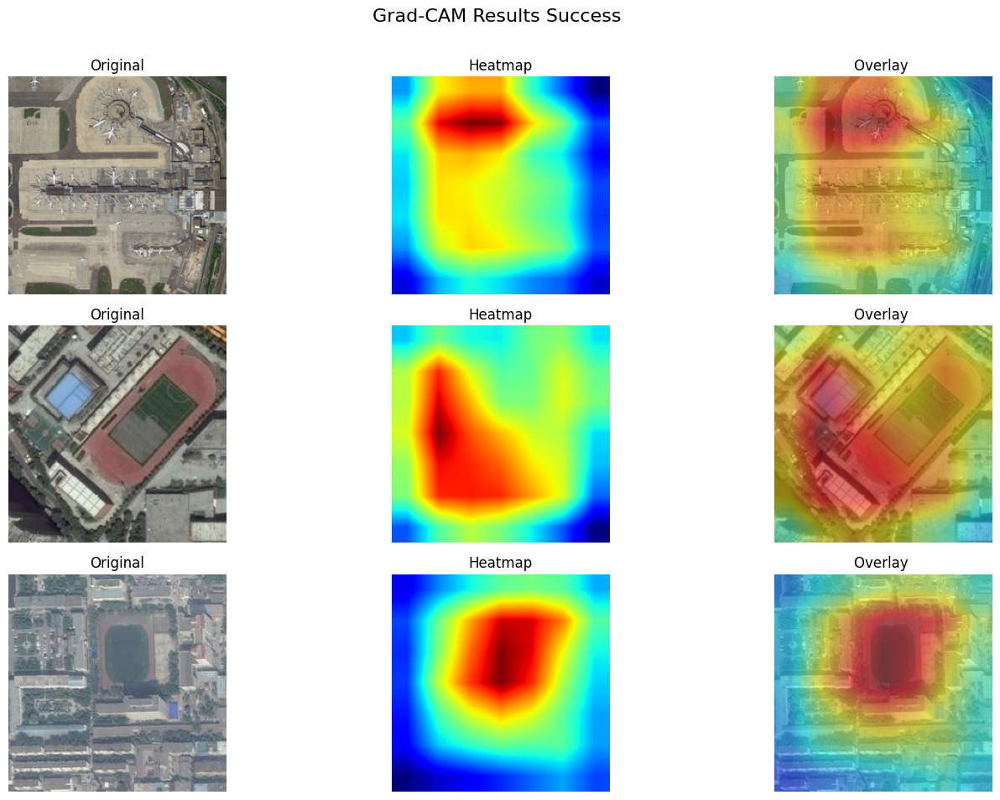

<Figure size 640x480 with 0 Axes>

In [166]:
# Updated Grad-CAM for multiple images
def generate_gradcam_multiple(image_paths, backbone, transform, device):
    results = []
    for image_path in image_paths:
        img_pil = Image.open(image_path).convert('RGB')
        img_tensor = transform(img_pil).unsqueeze(0).to(device)
        original_img = cv2.cvtColor(np.array(img_pil), cv2.COLOR_RGB2BGR)
        original_img = cv2.resize(original_img, (224, 224))
        
        # Target layer: last conv block of ResNet-18 (layer4)
        target_layer = backbone[7]
        grad_cam = GradCAM(backbone, target_layer)
        
        # Forward + target
        features = grad_cam.forward(img_tensor)
        target = features.norm()
        
        # Backward
        grad_cam.backward(target)
        
        activations = grad_cam.activations[0].cpu().numpy()
        gradients = grad_cam.gradients[0].cpu().numpy()
        weights = np.mean(gradients, axis=(1, 2))
        
        # Heatmap
        heatmap = np.zeros(activations.shape[1:], dtype=np.float32)
        for i, w in enumerate(weights):
            heatmap += w * activations[i, :, :]
        
        heatmap = np.maximum(heatmap, 0)
        heatmap /= np.max(heatmap) if np.max(heatmap) != 0 else 1
        heatmap = cv2.resize(heatmap, (224, 224))
        
        # Overlay
        heatmap_uint8 = np.uint8(255 * heatmap)
        heatmap_colored = cv2.applyColorMap(heatmap_uint8, cv2.COLORMAP_JET)
        superimposed_img = heatmap_colored * 0.5 + original_img * 0.5
        superimposed_img = np.clip(superimposed_img, 0, 255).astype(np.uint8)
        
        results.append((original_img, heatmap, superimposed_img))
    return results


# Example with 3 images
image_paths = [
    "/home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_2025_Guide-main/AML_Assignment/data/im_groot/airport_110.jpg",
    "/home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_2025_Guide-main/AML_Assignment/data/im_groot/00624.jpg",
    "/home/hiranmoy/Downloads/Sameer/MiDOG/MIDOG_2025_Guide-main/AML_Assignment/data/im_groot/00038.jpg"
]

results = generate_gradcam_multiple(image_paths, backbone, image_transform, device)

# Plot results
plt.figure(figsize=(15, 10))
for idx, (original_img, heatmap, superimposed_img) in enumerate(results):
    plt.subplot(len(results), 3, idx*3 + 1)
    plt.imshow(cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB))
    plt.title(f'Original')
    plt.axis('off')
    
    plt.subplot(len(results), 3, idx*3 + 2)
    plt.imshow(heatmap, cmap='jet')
    plt.title(f'Heatmap')
    plt.axis('off')
    
    plt.subplot(len(results), 3, idx*3 + 3)
    plt.imshow(cv2.cvtColor(superimposed_img, cv2.COLOR_BGR2RGB))
    plt.title(f'Overlay ')
    plt.axis('off')
plt.suptitle("Grad-CAM Results Success ", fontsize=16, y=0.95)
plt.tight_layout(rect=[0, 0, 1, 0.94])
plt.show()    

plt.tight_layout()
plt.show()




I did not implement checking rotation augmentation and its effects.
Another thing to try was to use vocabulary generated (pretrained) from Huggingface but I stuck to generating from train set only.

## Conclusion

For Hypothesizing failure causes - we take the 3 images for which the BLEU4 score cam the lowest.

Reasons can include - 

1. Inadequate vocabulary size as it was sugggested to have appx 10k wordss in vocab but I had <3500
2. Un-optimized models. Did not experiment enough with all possible vvalues of heads in transformers and layers in LSTM so as to know which the best could be
3. Caption format. Splittraining into 1 image * number of different captions it originally had. Doing that at test as well could confuse the model of which caption to be most apt.
4. Peers worked directly on the rawstring format of the data obtained better results. Reason being unknown but that could also contribute.
5. Words differ significantly but the description is exact - this generates good caption but bad scores.